# COMPOSICIÓN DE VARIABLES CLIMÁTICAS

In [1]:
# CÓDIGO PARA COMPROBAR Y CAMBIAR EL DIRECTORIO DE TRABAJO
# (DEFINIDO DIRECTORIO DE TRABAJO DONDE ESTÁ GUARDADO EL PRESENTE SCRIPT) 

import os
# Current working directory:
cwd = os.getcwd()
#print('Current working directory: ', cwd)
# Change working directory:
#os.chdir('C:\Users\FAL\Desktop\TFM_MEDS21\Code')
#cwd = os.getcwd()
print('Current working directory: ', cwd)


Current working directory:  C:\Users\FAL\Desktop\TFM_MEDS21\Code


In [2]:
#!pip install pandas_profiling
#!pip install miceforest
#!pip install category_encoders
#!pip install xgboost

In [3]:
import pandas as pd
import numpy as np
import datetime as dt
import miceforest as mf

import pandas_profiling
import sklearn
import matplotlib
import scipy
import statsmodels
import mlxtend
import category_encoders
import seaborn
import xgboost

In [4]:
import matplotlib.pyplot as plt
import matplotlib.colors as ma
import matplotlib.font_manager as fm

In [5]:
import glob
from PIL import Image as pil_Image
from IPython.display import Image as disp_Image

In [6]:
%matplotlib inline

## 1. CARGA Y PREPARACIÓN DE DATOS

### - Datos climáticos y genéricos de estaciones AEMET

Para la obtención de datos climáticos para el modelo se decide utilizar los datos nacionales en abierto de AEMET. 

En cuanto al procedimiento seguido para la descarga, comprobación y preparación de los datos, se han seguido los siguientes pasos:

   - Se definen 2 herramientas (notebooks en Python y R) para la conexión con la API de AEMET y la obtención de los datos.
   - Se parte de un listado inicial de 291 estaciones AEMET, se filtran las estaciones no peninsulares (modelo de demanda peninsular no las utiliza) quedando 258 estaciones y se solicitan los datos de las mismas desde el 2019-01-01 hasta el 2021-12-31.
   - De las 258 estaciones se obtienen datos de 225 (33 estaciones con error de solicitud).
   - Los datos cargados a continuación son los de las 225 estaciones con datos accesibles, los cuáles se van analizar para comprobar si se pueden emplear en el modelo y prepararlos en su caso.

LISTADO ESTACIONES AEMET (291 est. iniciales):
  - 258 est. peninsulares (33 no penins.)
  - 225 est. datos AEMET (33 req. error) 
  

In [ ]:
PATH = "../Data_in/3.3_Climatologia/Comp. vars. climaticas/3.2_Geolocalizacion (GEOPY)/Mapas/"
disp_Image(filename = PATH + "Mapa_0.png", width=600, height=600)

In [ ]:
PATH = "../Data_in/3.3_Climatologia/Comp. vars. climaticas/3.2_Geolocalizacion (GEOPY)/Mapas/"
disp_Image(filename = PATH + "Mapa_1.png", width=600, height=600)

In [9]:
# CARGA DATOS

data_in1 = "../Data_in/3.3_Climatologia/Comp. vars. climaticas/_Est. AEMET/1_Solicitud datos/Est. AEMET+Muni. INE (np-re).xlsx"
data_in2 = "../Data_in/3.3_Climatologia/Comp. vars. climaticas/3.2_Geolocalizacion (GEOPY)/EstAEMET_coord (258 est).csv"

Est_df = pd.read_excel(data_in1, header='infer', dtype={'Ind_AEMET':'string','Altitud':'int64','Provincia':'string',
                                                        'Nombre':'string','Ind_INE':'string','Provincia_Loc':'string',
                                                        'Nombre_Loc':'string','No_penins':'int64','Req_error':'int64'})

EstCoord_df = pd.read_csv(data_in2, sep=",", header='infer', index_col=None, infer_datetime_format=True, 
                         encoding="ISO 8859-1", decimal='.', na_values=np.nan,
                         dtype={'Ind_AEMET':'string', 'Longitude':'float64','Latitude':'float64'})


In [10]:
# CARGA DATOS

data_in1 = "../Data_in/3.3_Climatologia/Comp. vars. climaticas/3.3.1_AEMET-master (Python)/1_Solicitud datos/2014-2021/DatosHist_2014-2016 (291i-33np-33err est.).csv"
data_in2 = "../Data_in/3.3_Climatologia/Comp. vars. climaticas/3.3.1_AEMET-master (Python)/1_Solicitud datos/2014-2021/DatosHist_2017-2018 (291i-33np-33err est.).csv"
data_in3 = "../Data_in/3.3_Climatologia/Comp. vars. climaticas/3.3.1_AEMET-master (Python)/1_Solicitud datos/2014-2021/DatosHist_2018-2022 (8501).csv"
data_in4 = "../Data_in/3.3_Climatologia/Comp. vars. climaticas/3.3.1_AEMET-master (Python)/1_Solicitud datos/2014-2021/DatosHist_2019-2022 (291i-33np-33err est.).csv"

PyAEMET_df1 = pd.read_csv(data_in1, sep=",", header='infer', index_col=None, infer_datetime_format=True, 
                         encoding="ISO 8859-1", decimal='.', na_values=np.nan,
                         dtype={'Ind_AEMET':'string','Ind_INE':'string','Provincia':'string',
                                'Nombre':'string','Tmax':'float64', 'Tmin':'float64'})

PyAEMET_df2 = pd.read_csv(data_in2, sep=",", header='infer', index_col=None, infer_datetime_format=True, 
                         encoding="ISO 8859-1", decimal='.', na_values=np.nan,
                         dtype={'Ind_AEMET':'string','Ind_INE':'string','Provincia':'string',
                                'Nombre':'string','Tmax':'float64', 'Tmin':'float64'})

PyAEMET_df3 = pd.read_csv(data_in3, sep=",", header='infer', index_col=None, infer_datetime_format=True, 
                         encoding="ISO 8859-1", decimal='.', na_values=np.nan,
                         dtype={'Ind_AEMET':'string','Ind_INE':'string','Provincia':'string',
                                'Nombre':'string','Tmax':'float64', 'Tmin':'float64'})


PyAEMET_df4 = pd.read_csv(data_in4, sep=",", header='infer', index_col=None, infer_datetime_format=True, 
                         encoding="ISO 8859-1", decimal='.', na_values=np.nan,
                         dtype={'Ind_AEMET':'string','Ind_INE':'string','Provincia':'string',
                                'Nombre':'string','Tmax':'float64', 'Tmin':'float64'})

print(PyAEMET_df1.shape)
print(PyAEMET_df2.shape)
print(PyAEMET_df3.shape)
print(PyAEMET_df4.shape)


(236846, 7)
(158694, 7)
(256, 7)
(233405, 7)


In [11]:
PyAEMET_df = pd.concat([PyAEMET_df1,PyAEMET_df2,PyAEMET_df3,PyAEMET_df4]).sort_values(by='Ind_AEMET').reset_index(drop=True)
PyAEMET_df

,Fecha,Ind_AEMET,Ind_INE,Provincia,Nombre,Tmax,Tmin
0,2019-12-01,0002I,43162,TARRAGONA,VANDELLÒS,17.0,8.8
1,2015-04-13,0002I,43162,TARRAGONA,VANDELLÒS,19.7,9.2
2,2015-04-12,0002I,43162,TARRAGONA,VANDELLÒS,19.2,10.5
3,2015-04-11,0002I,43162,TARRAGONA,VANDELLÒS,18.1,10.2
4,2015-04-10,0002I,43162,TARRAGONA,VANDELLÒS,17.3,9.8
...,...,...,...,...,...,...,...
629196,2015-12-31,9990X,25025,LLEIDA,"NAUT ARAN, ARTIES",10.2,1.6
629197,2015-12-30,9990X,25025,LLEIDA,"NAUT ARAN, ARTIES",15.3,3.3
629198,2015-12-29,9990X,25025,LLEIDA,"NAUT ARAN, ARTIES",10.6,1.4
629199,2016-01-08,9990X,25025,LLEIDA,"NAUT ARAN, ARTIES",12.7,6.8


In [12]:
data_in1 = "../Data_in/3.3_Climatologia/Comp. vars. climaticas/3.3.2_Climaemet (R)/1_Solicitud datos/DatosHist_2014-2021 (240 est).csv"

RsAEMET_df = pd.read_csv(data_in1, sep=",", header='infer', index_col=None, infer_datetime_format=True, 
                         encoding="ISO 8859-1", decimal='.', na_values=np.nan,
                         dtype={'Ind_AEMET':'string','Ind_INE':'string','Provincia':'string',
                                'Nombre':'string','Tmax':'float64', 'Tmin':'float64'})

print(RsAEMET_df.shape)

(644164, 7)


In [13]:
RsAEMET_df

,Fecha,Ind_AEMET,Ind_INE,Provincia,Nombre,Tmax,Tmin
0,2017-11-19,0002I,43162,TARRAGONA,VANDELLÒS,17.0,9.7
1,2016-10-20,0002I,43162,TARRAGONA,VANDELLÒS,19.4,13.4
2,2021-07-03,0002I,43162,TARRAGONA,VANDELLÒS,NaN,NaN
3,2017-09-16,0002I,43162,TARRAGONA,VANDELLÒS,23.0,13.3
4,2017-04-23,0002I,43162,TARRAGONA,VANDELLÒS,19.3,8.7
...,...,...,...,...,...,...,...
644159,2021-10-27,9990X,25025,LLEIDA,"NAUT ARAN, ARTIES",18.7,0.7
644160,2018-01-09,9990X,25025,LLEIDA,"NAUT ARAN, ARTIES",3.8,-3.2
644161,2017-12-31,9990X,25025,LLEIDA,"NAUT ARAN, ARTIES",9.7,-1.4
644162,2016-02-20,9990X,25025,LLEIDA,"NAUT ARAN, ARTIES",12.5,-4.8


In [14]:
PyAEMET_df['Fecha'] = pd.to_datetime(PyAEMET_df['Fecha'])
RsAEMET_df['Fecha'] = pd.to_datetime(RsAEMET_df['Fecha'])

In [15]:
# Filtramos los datos (fecha 2019-01-01 a 2021-12-31)
PyAEMET_df = PyAEMET_df[(PyAEMET_df['Fecha']>='2014-01-01') & (PyAEMET_df['Fecha']<='2021-12-31')]
RsAEMET_df = RsAEMET_df[(RsAEMET_df['Fecha']>='2014-01-01') & (RsAEMET_df['Fecha']<='2021-12-31')]

## 2. ANÁLISIS PREVIO DE LOS DATOS

### 2.1. Datos genéricos estaciones AEMET

Se parte de los datos generales de las 291 estaciones AEMET de la lista inicial para definir el dataframe con las 225 estaciones peninsulares que permiten el acceso a sus datos climáticos.

In [16]:
# Obtenemos los listados de estaciones

Est0_df = Est_df[Est_df['No_penins']!=1].copy()
Est1_df = Est0_df[Est0_df['Req_error']!=1].copy()
Est1_df.reset_index(level=None, drop=True, inplace=True, col_level=0, col_fill='')

drop_list = ['No_penins','Req_error']
Est1_df.drop(axis=1, columns=drop_list, level=None, inplace=True, errors='raise')


In [17]:
est_iniciales = list(Est_df['Ind_AEMET'])
len(est_iniciales)

291

In [18]:
est_penins = list(Est0_df['Ind_AEMET'])
len(est_penins)

258

In [19]:
est_pen_sinerr = list(Est1_df['Ind_AEMET'])
len(est_pen_sinerr)

240

In [20]:
Est1_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 240 entries, 0 to 239
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   Ind_AEMET      240 non-null    string
 1   Altitud        240 non-null    int64 
 2   Provincia      240 non-null    string
 3   Nombre         240 non-null    string
 4   Ind_INE        240 non-null    string
 5   Provincia_Loc  240 non-null    string
 6   Nombre_Loc     240 non-null    string
dtypes: int64(1), string(6)
memory usage: 13.2 KB


In [21]:
Est1_df.describe()

,Altitud
count,240.000000
mean,482.108333
std,420.898507
min,1.000000
25%,74.750000
50%,446.000000
75%,760.750000
max,1960.000000


In [22]:
Est1_df

,Ind_AEMET,Altitud,Provincia,Nombre,Ind_INE,Provincia_Loc,Nombre_Loc
0,0076,4,BARCELONA,BARCELONA AEROPUERTO,08169,Barcelona,Barcelona Aeropuerto
1,0367,143,GIRONA,GIRONA AEROPUERTO,17002,Girona,Girona Aeropuerto
2,1014,4,GIPUZKOA,"HONDARRIBIA, MALKARROA",20036,Gipuzkoa,Hondarribia
3,1082,42,BIZKAIA,BILBAO AEROPUERTO,48904,Bizkaia,Bilbao Aeropuerto
4,1109,3,CANTABRIA,SANTANDER AEROPUERTO,39008,Cantabria,Santander Aeropuerto
...,...,...,...,...,...,...,...
235,9784P,992,HUESCA,BIELSA,22057,Huesca,Bielsa
236,9814A,1020,HUESCA,TORLA,22230,Huesca,Torla
237,9981A,50,TARRAGONA,ESTACION DE TORTOSA (ROQUETES),43155,Tarragona,Tortosa Roquetes
238,9987P,1,TARRAGONA,SANT JAUME D'ENVEJA,43902,Tarragona,Sant Jaume D'Enveja


### 2.2. Coordenadas estaciones AEMET

Se define el dataframe con las coordenadas de las 258 estaciones peninsulares (en caso de ser necesarios estos datos posteriormente).

In [23]:
EstCoord_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 258 entries, 0 to 257
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Ind_AEMET  258 non-null    string 
 1   Longitude  258 non-null    float64
 2   Latitude   258 non-null    float64
dtypes: float64(2), string(1)
memory usage: 6.2 KB


In [24]:
EstCoord_df.describe()

,Longitude,Latitude
count,258.000000,258.000000
mean,-3.443029,40.463490
std,2.688295,2.207180
min,-9.263789,35.939152
25%,-5.588695,38.513432
50%,-3.612773,40.689865
75%,-1.642787,42.427429
max,2.819944,43.790312


In [25]:
EstCoord_df

,Ind_AEMET,Longitude,Latitude
0,0076,2.079047,41.296944
1,0367,2.762426,41.904495
2,1014,-1.797246,43.367157
3,1082,-2.919130,43.301721
4,1109,-3.822845,43.427161
...,...,...,...
253,9784P,0.218859,42.633555
254,9814A,-0.657212,42.532566
255,9981A,0.508664,40.796329
256,9987P,0.718289,40.706285


In [26]:
print(EstCoord_df['Longitude'].max())
print(EstCoord_df['Longitude'].min())

2.8199439
-9.263789


In [27]:
print(EstCoord_df['Latitude'].max())
print(EstCoord_df['Latitude'].min())

43.7903123
35.9391523


### 2.2. Datos climáticos: AEMET-master (Python)

Se define el dataframe con las observaciones de las 225 estaciones peninsulares con datos disponibles obtenidas mediante "AEMET-master" (Python).

In [28]:
PyAEMET_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 628784 entries, 0 to 629199
Data columns (total 7 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   Fecha      628784 non-null  datetime64[ns]
 1   Ind_AEMET  628784 non-null  string        
 2   Ind_INE    628784 non-null  string        
 3   Provincia  628784 non-null  string        
 4   Nombre     628784 non-null  string        
 5   Tmax       611314 non-null  float64       
 6   Tmin       611167 non-null  float64       
dtypes: datetime64[ns](1), float64(2), string(4)
memory usage: 38.4 MB


In [29]:
PyAEMET_df.describe()

,Tmax,Tmin
count,611314.000000,611167.000000
mean,20.762453,9.667923
std,8.097537,6.616299
min,-8.100000,-25.200000
25%,14.800000,4.900000
50%,20.100000,9.700000
75%,26.700000,14.600000
max,47.000000,30.200000


In [30]:
PyAEMET_df

,Fecha,Ind_AEMET,Ind_INE,Provincia,Nombre,Tmax,Tmin
0,2019-12-01,0002I,43162,TARRAGONA,VANDELLÒS,17.0,8.8
1,2015-04-13,0002I,43162,TARRAGONA,VANDELLÒS,19.7,9.2
2,2015-04-12,0002I,43162,TARRAGONA,VANDELLÒS,19.2,10.5
3,2015-04-11,0002I,43162,TARRAGONA,VANDELLÒS,18.1,10.2
4,2015-04-10,0002I,43162,TARRAGONA,VANDELLÒS,17.3,9.8
...,...,...,...,...,...,...,...
629195,2016-01-01,9990X,25025,LLEIDA,"NAUT ARAN, ARTIES",14.5,2.2
629196,2015-12-31,9990X,25025,LLEIDA,"NAUT ARAN, ARTIES",10.2,1.6
629197,2015-12-30,9990X,25025,LLEIDA,"NAUT ARAN, ARTIES",15.3,3.3
629198,2015-12-29,9990X,25025,LLEIDA,"NAUT ARAN, ARTIES",10.6,1.4


In [31]:
PyAEMET_df.isnull().sum()

Fecha            0
Ind_AEMET        0
Ind_INE          0
Provincia        0
Nombre           0
Tmax         17470
Tmin         17617
dtype: int64

### 2.3. Datos climáticos: Climaemet (R)

Se define el dataframe con las observaciones de las 225 estaciones peninsulares con datos disponibles obtenidas mediante "Climaemet" (R).

In [32]:
RsAEMET_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 640441 entries, 0 to 644163
Data columns (total 7 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   Fecha      640441 non-null  datetime64[ns]
 1   Ind_AEMET  640441 non-null  string        
 2   Ind_INE    640441 non-null  string        
 3   Provincia  640441 non-null  string        
 4   Nombre     640441 non-null  string        
 5   Tmax       620869 non-null  float64       
 6   Tmin       620719 non-null  float64       
dtypes: datetime64[ns](1), float64(2), string(4)
memory usage: 39.1 MB


In [33]:
RsAEMET_df.describe()

,Tmax,Tmin
count,620869.000000,620719.000000
mean,20.748002,9.639122
std,8.102299,6.616627
min,-8.100000,-25.200000
25%,14.800000,4.800000
50%,20.100000,9.600000
75%,26.700000,14.500000
max,47.000000,30.200000


In [34]:
RsAEMET_df

,Fecha,Ind_AEMET,Ind_INE,Provincia,Nombre,Tmax,Tmin
0,2017-11-19,0002I,43162,TARRAGONA,VANDELLÒS,17.0,9.7
1,2016-10-20,0002I,43162,TARRAGONA,VANDELLÒS,19.4,13.4
2,2021-07-03,0002I,43162,TARRAGONA,VANDELLÒS,NaN,NaN
3,2017-09-16,0002I,43162,TARRAGONA,VANDELLÒS,23.0,13.3
4,2017-04-23,0002I,43162,TARRAGONA,VANDELLÒS,19.3,8.7
...,...,...,...,...,...,...,...
644159,2021-10-27,9990X,25025,LLEIDA,"NAUT ARAN, ARTIES",18.7,0.7
644160,2018-01-09,9990X,25025,LLEIDA,"NAUT ARAN, ARTIES",3.8,-3.2
644161,2017-12-31,9990X,25025,LLEIDA,"NAUT ARAN, ARTIES",9.7,-1.4
644162,2016-02-20,9990X,25025,LLEIDA,"NAUT ARAN, ARTIES",12.5,-4.8


In [35]:
RsAEMET_df.isnull().sum()

Fecha            0
Ind_AEMET        0
Ind_INE          0
Provincia        0
Nombre           0
Tmax         19572
Tmin         19722
dtype: int64

## 3. ANÁLISIS DE "OUTLIERS" Y "MISSING VALUES"

En este caso y debido a las propias características de los datos y su origen no se considerará la presencia de "outliers" pero si va a ser necesario el análisis y tratamiento de "missing values".

### 3.1. Combinación de datasets: AEMET-master (Python) y Climaemet (R)

Se han obtenido datos climáticos de las estaciones de AEMET mediante dos procedimientos diferentes:

   - Aplicación AEMET-master (Python)
   - Librería Climaemet (R)

Los datos obtenidos no son exactamente iguales, pareciendo más completos los obtenidos mediante la aplicación "AEMET-master", aunque ambas bases de datos contienen "missing vallues". Por ello se procede a cruzar ambas bases de datos para tratar de obtener una conjunta lo más completa posible. Una vez obtenida la base de datos conjunta se estudiará el tratamiento a aplicar a los "missing values" restantes.

In [36]:
Clima_df = pd.merge(PyAEMET_df, RsAEMET_df, how="outer", on=['Fecha','Ind_AEMET'], sort=False, suffixes=('', '_ClimaR'))

In [37]:
Clima_df

,Fecha,Ind_AEMET,Ind_INE,Provincia,Nombre,Tmax,Tmin,Ind_INE_ClimaR,Provincia_ClimaR,Nombre_ClimaR,Tmax_ClimaR,Tmin_ClimaR
0,2019-12-01,0002I,43162,TARRAGONA,VANDELLÒS,17.0,8.8,43162,TARRAGONA,VANDELLÒS,17.0,8.8
1,2015-04-13,0002I,43162,TARRAGONA,VANDELLÒS,19.7,9.2,43162,TARRAGONA,VANDELLÒS,19.7,9.2
2,2015-04-12,0002I,43162,TARRAGONA,VANDELLÒS,19.2,10.5,43162,TARRAGONA,VANDELLÒS,19.2,10.5
3,2015-04-11,0002I,43162,TARRAGONA,VANDELLÒS,18.1,10.2,43162,TARRAGONA,VANDELLÒS,18.1,10.2
4,2015-04-10,0002I,43162,TARRAGONA,VANDELLÒS,17.3,9.8,43162,TARRAGONA,VANDELLÒS,17.3,9.8
...,...,...,...,...,...,...,...,...,...,...,...,...
640692,2015-04-09,9814A,<NA>,<NA>,<NA>,NaN,NaN,22230,HUESCA,TORLA,17.3,1.1
640693,2015-08-03,9814A,<NA>,<NA>,<NA>,NaN,NaN,22230,HUESCA,TORLA,30.6,14.2
640694,2015-05-23,9814A,<NA>,<NA>,<NA>,NaN,NaN,22230,HUESCA,TORLA,18.4,5.7
640695,2016-03-11,9814A,<NA>,<NA>,<NA>,NaN,NaN,22230,HUESCA,TORLA,9.4,-0.7


In [38]:
Clima_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 640697 entries, 0 to 640696
Data columns (total 12 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   Fecha             640697 non-null  datetime64[ns]
 1   Ind_AEMET         640697 non-null  object        
 2   Ind_INE           628784 non-null  string        
 3   Provincia         628784 non-null  string        
 4   Nombre            628784 non-null  string        
 5   Tmax              611314 non-null  float64       
 6   Tmin              611167 non-null  float64       
 7   Ind_INE_ClimaR    640697 non-null  string        
 8   Provincia_ClimaR  640697 non-null  string        
 9   Nombre_ClimaR     640697 non-null  string        
 10  Tmax_ClimaR       620869 non-null  float64       
 11  Tmin_ClimaR       620719 non-null  float64       
dtypes: datetime64[ns](1), float64(4), object(1), string(6)
memory usage: 63.5+ MB


In [39]:
# Definimos función para cruzar los datos de las columnas correspondientes (sólo los missing values)

def fill_na_col(df_input, colFill_input, colValues_input):
    
    df_out = df_input.copy()
    nrows = df_input.shape[0]
    
    for i in range(0,nrows):
        fill_value = df_input[colValues_input][i]
        
        if pd.isnull(fill_value)!=True:
            df_out.at[i, colFill_input] = fill_value
        else:
            continue
            
    return df_out
            

In [40]:
duplicate = Clima_df[Clima_df.duplicated(['Fecha', 'Ind_AEMET'])]
duplicate

,Fecha,Ind_AEMET,Ind_INE,Provincia,Nombre,Tmax,Tmin,Ind_INE_ClimaR,Provincia_ClimaR,Nombre_ClimaR,Tmax_ClimaR,Tmin_ClimaR
536410,2021-07-06,8501,12040,CASTELLON,CASTELLÓ DE LA PLANA,NaN,NaN,12040,CASTELLON,CASTELLÓ DE LA PLANA,NaN,NaN
536412,2021-07-05,8501,12040,CASTELLON,CASTELLÓ DE LA PLANA,NaN,NaN,12040,CASTELLON,CASTELLÓ DE LA PLANA,NaN,NaN
536414,2021-07-04,8501,12040,CASTELLON,CASTELLÓ DE LA PLANA,NaN,NaN,12040,CASTELLON,CASTELLÓ DE LA PLANA,NaN,NaN
536416,2021-07-03,8501,12040,CASTELLON,CASTELLÓ DE LA PLANA,NaN,NaN,12040,CASTELLON,CASTELLÓ DE LA PLANA,NaN,NaN
536418,2021-07-02,8501,12040,CASTELLON,CASTELLÓ DE LA PLANA,NaN,NaN,12040,CASTELLON,CASTELLÓ DE LA PLANA,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
536912,2021-09-27,8501,12040,CASTELLON,CASTELLÓ DE LA PLANA,NaN,NaN,12040,CASTELLON,CASTELLÓ DE LA PLANA,NaN,NaN
536914,2021-09-28,8501,12040,CASTELLON,CASTELLÓ DE LA PLANA,NaN,NaN,12040,CASTELLON,CASTELLÓ DE LA PLANA,NaN,NaN
536916,2021-09-30,8501,12040,CASTELLON,CASTELLÓ DE LA PLANA,NaN,NaN,12040,CASTELLON,CASTELLÓ DE LA PLANA,NaN,NaN
536918,2021-08-29,8501,12040,CASTELLON,CASTELLÓ DE LA PLANA,NaN,NaN,12040,CASTELLON,CASTELLÓ DE LA PLANA,NaN,NaN


In [41]:
# Tratamos de completar los "missing values"

Clima_df = fill_na_col(Clima_df, 'Ind_INE', 'Ind_INE_ClimaR')
Clima_df = fill_na_col(Clima_df, 'Provincia', 'Provincia_ClimaR')
Clima_df = fill_na_col(Clima_df, 'Nombre', 'Nombre_ClimaR')
Clima_df = fill_na_col(Clima_df, 'Tmax', 'Tmax_ClimaR')
Clima_df = fill_na_col(Clima_df, 'Tmin', 'Tmin_ClimaR')

drop_list = ['Ind_INE_ClimaR', 'Provincia_ClimaR', 'Nombre_ClimaR', 'Tmax_ClimaR', 'Tmin_ClimaR']

Clima_df = Clima_df.drop_duplicates(subset=['Fecha', 'Ind_AEMET'], keep='first', inplace=False, ignore_index=False)
Clima_df = Clima_df.drop(axis=1, columns=drop_list, level=None, inplace=False, errors='raise')

In [42]:
Clima_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 640441 entries, 0 to 640696
Data columns (total 7 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   Fecha      640441 non-null  datetime64[ns]
 1   Ind_AEMET  640441 non-null  object        
 2   Ind_INE    640441 non-null  string        
 3   Provincia  640441 non-null  string        
 4   Nombre     640441 non-null  string        
 5   Tmax       620870 non-null  float64       
 6   Tmin       620720 non-null  float64       
dtypes: datetime64[ns](1), float64(2), object(1), string(3)
memory usage: 39.1+ MB


In [43]:
Clima_df.describe()

,Tmax,Tmin
count,620870.000000,620720.000000
mean,20.747986,9.639113
std,8.102303,6.616626
min,-8.100000,-25.200000
25%,14.800000,4.800000
50%,20.100000,9.600000
75%,26.700000,14.500000
max,47.000000,30.200000


In [44]:
Clima_df

,Fecha,Ind_AEMET,Ind_INE,Provincia,Nombre,Tmax,Tmin
0,2019-12-01,0002I,43162,TARRAGONA,VANDELLÒS,17.0,8.8
1,2015-04-13,0002I,43162,TARRAGONA,VANDELLÒS,19.7,9.2
2,2015-04-12,0002I,43162,TARRAGONA,VANDELLÒS,19.2,10.5
3,2015-04-11,0002I,43162,TARRAGONA,VANDELLÒS,18.1,10.2
4,2015-04-10,0002I,43162,TARRAGONA,VANDELLÒS,17.3,9.8
...,...,...,...,...,...,...,...
640692,2015-04-09,9814A,22230,HUESCA,TORLA,17.3,1.1
640693,2015-08-03,9814A,22230,HUESCA,TORLA,30.6,14.2
640694,2015-05-23,9814A,22230,HUESCA,TORLA,18.4,5.7
640695,2016-03-11,9814A,22230,HUESCA,TORLA,9.4,-0.7


In [45]:
duplicate = Clima_df[Clima_df.duplicated(['Fecha', 'Ind_AEMET'])]
duplicate

,Fecha,Ind_AEMET,Ind_INE,Provincia,Nombre,Tmax,Tmin


In [46]:
Clima_df[(Clima_df['Fecha']=='2021-07-06') & (Clima_df['Ind_AEMET']=='8501')]

,Fecha,Ind_AEMET,Ind_INE,Provincia,Nombre,Tmax,Tmin
536409,2021-07-06,8501,12040,CASTELLON,CASTELLÓ DE LA PLANA,NaN,NaN


In [47]:
Clima_df.shape

(640441, 7)

Como considerábamos con antelación, el dataset de AEMET-master (Python) es más completo que el de Climaemet (R) y contiene todos sus datos, por lo que éste último no aporta nuevos valores que reduzcan los "missing values" del primero.

In [48]:
EstReq_df = pd.DataFrame(Clima_df['Ind_AEMET'].unique(), columns=['Ind_AEMET'])
EstReq_df.shape

(240, 1)

In [49]:
EstReq_df

,Ind_AEMET
0,0002I
1,0016A
2,0076
3,0149X
4,0200E
...,...
235,6268X
236,6381
237,9283X
238,9576C


In [50]:
data_out1 = '../Data_in/3.3_Climatologia/Comp. vars. climaticas/_Est. AEMET/2_Análisis datos/Est_Datos_2014-2021 (np-re, 240).csv'       
EstReq_df.to_csv(data_out1, index=False, encoding="ISO 8859-1")

### 3.2. Análisis de datos por estaciones AEMET

En este apartado se van a analizar los datos obtenidos por estación, revisando los "missing values", de manera que se pueda decidir qué estaciones se pueden emplear y cuáles hay que descartar. Una vez decididas las estaciones finales a utilizar en el modelo también se pueden analizar los "missing values" finales del dataset y decidir cuáles son los posibles tratamientos a aplicar.

In [51]:
ini = dt.datetime(2014,1,1)
fin = dt.datetime(2021,12,31)

lista_dias = pd.date_range(ini,fin,freq='D')
lista_dias

DatetimeIndex(['2014-01-01', '2014-01-02', '2014-01-03', '2014-01-04',
               '2014-01-05', '2014-01-06', '2014-01-07', '2014-01-08',
               '2014-01-09', '2014-01-10',
               ...
               '2021-12-22', '2021-12-23', '2021-12-24', '2021-12-25',
               '2021-12-26', '2021-12-27', '2021-12-28', '2021-12-29',
               '2021-12-30', '2021-12-31'],
              dtype='datetime64[ns]', length=2922, freq='D')

In [52]:
ini = '2014-01-01'
fin = '2021-12-31'

lista_dias = pd.date_range(ini,fin,freq='D')
lista_dias

DatetimeIndex(['2014-01-01', '2014-01-02', '2014-01-03', '2014-01-04',
               '2014-01-05', '2014-01-06', '2014-01-07', '2014-01-08',
               '2014-01-09', '2014-01-10',
               ...
               '2021-12-22', '2021-12-23', '2021-12-24', '2021-12-25',
               '2021-12-26', '2021-12-27', '2021-12-28', '2021-12-29',
               '2021-12-30', '2021-12-31'],
              dtype='datetime64[ns]', length=2922, freq='D')

In [53]:
len(lista_dias)

2922

In [54]:
# Definimos función para obtener los "missing values", observaciones y fecha inicial/final para cada estación

def nan_estaciones(df_input, col_IndAEMET, ini_datos, fin_datos):
    IndAEMET_list = list(set(df_input[col_IndAEMET]))
    n_est = len(IndAEMET_list)
    
    Total_obs = len(pd.date_range(ini_datos, fin_datos, freq='D'))
    
    keys = list(df_input.keys())
    new_cols = ['N_obs','N_miss','%_miss','Fecha_min','Fecha_max']
    cols = keys + new_cols
    df_nan = pd.DataFrame(columns=cols)
    
    for i in range(0,n_est):
        est = IndAEMET_list[i]
        est_df = df_input[df_input[col_IndAEMET]==est]
        
        row_nans = est_df.isnull().sum()
        est_obs = est_df.count()[0]
        N_nan_max = max(est_df.isnull().sum()[5],est_df.isnull().sum()[6])
        
        
        for j in range(0,len(cols)):
            col = cols[j]
            
            if col=='Ind_AEMET':
                df_nan.at[i, col] = est
                continue
            if col=='N_obs':
                df_nan.at[i, col] = est_obs
                continue
            if col=='N_no_miss':
                df_nan.at[i, col] = est_obs
                continue
            if col=='N_miss':
                df_nan.at[i, col] = (Total_obs - est_obs) + N_nan_max
                continue
            if col=='%_miss':
                df_nan.at[i, col] = (((Total_obs - est_obs) + N_nan_max) / Total_obs)
                continue
            if col=='Fecha':
                df_nan.at[i, col] = row_nans[0]
                df_nan.at[i, 'Fecha_min'] = est_df['Fecha'].min()
                df_nan.at[i, 'Fecha_max'] = est_df['Fecha'].max()
                continue                   
            else:
                try:
                    df_nan.at[i, col] = row_nans[j]
                except:
                    continue

        #df_nan = df_nan.astype({'Fecha':'int64','Ind_AEMET':'string', 'Longitude':'int64', 'Latitude':'int64',
                                #'Tmax':'int64', 'Tmin':'int64', 'UVmax':'int64', 'N_obs':'int64'})
    return df_nan


In [55]:
Clima_df_nan = nan_estaciones(Clima_df,'Ind_AEMET', ini_datos='2014-01-01', fin_datos='2021-12-31')

In [56]:
Clima_df_nan['Fecha_min'] = pd.to_datetime(Clima_df_nan['Fecha_min'])
Clima_df_nan['Fecha_max'] = pd.to_datetime(Clima_df_nan['Fecha_max'])

In [57]:
Clima_df_nan

,Fecha,Ind_AEMET,Ind_INE,Provincia,Nombre,Tmax,Tmin,N_obs,N_miss,%_miss,Fecha_min,Fecha_max
0,0,3168C,0,0,0,2,2,403,2521,0.862765,2014-01-01,2015-08-02
1,0,3298X,0,0,0,620,620,2736,806,0.275838,2014-01-01,2021-12-31
2,0,8368U,0,0,0,0,0,2922,0,0.0,2014-01-01,2021-12-31
3,0,1690A,0,0,0,0,0,2922,0,0.0,2014-01-01,2021-12-31
4,0,2614,0,0,0,1,1,2922,1,0.000342,2014-01-01,2021-12-31
...,...,...,...,...,...,...,...,...,...,...,...,...
235,0,4220X,0,0,0,445,445,2643,724,0.247775,2014-01-01,2021-12-31
236,0,3200,0,0,0,0,0,2922,0,0.0,2014-01-01,2021-12-31
237,0,6268X,0,0,0,37,37,198,2761,0.944901,2014-01-01,2016-12-13
238,0,6277B,0,0,0,74,73,2660,336,0.11499,2014-01-01,2021-12-31


In [93]:
data_out1 = '../Data_in/3.3_Climatologia/Comp. vars. climaticas/_Est. AEMET/2_Análisis datos/Est_MissValues_2014-2021 (np-re, 240).csv'       
Clima_df_nan.to_csv(data_out1, index=False, encoding="ISO 8859-1")

Se analiza la tabla obtenida con "missing values", observaciones y fecha inicial/final para cada estación:

- Dado el intervalo de tiempo definido: 2014-01-01 a 2021-12-31, para considerar una estación con datos completos ésta debería tener unas 2922 observaciones. La completitud de cada estación la podemos analizar mediante las variables de la tabla: "N_obs", N_miss, %_miss, "Fecha_min" y "Fecha_max".


- Adicionalmente al número de observaciones es necesario analizar también el número de "missing values" presentes en dichas observaciones. Este apartado lo podemos revisar con las columnas de cada variable del dataset, salvo la variable "Ind_AEMET" que recoge el código de identif. de la estación, y que se han definido en la tabla para que recojan el número de "missing values" de cada variable para cada estación.

Teniendo en cuenta los aspectos anteriores se analizan todas las estaciones y finalmente se deciden las definitivas a utilizar para el modelo.

In [58]:
# 1er filtrado: SELECCIONAMOS SÓLO ESTACIONES QUE PROPORCIONAN DATOS A DÍA DE HOY (buscamos estabilidad)

Clima_df_nan1 = Clima_df_nan[Clima_df_nan['Fecha_max']=='2021-12-31']
Clima_df_nan1

,Fecha,Ind_AEMET,Ind_INE,Provincia,Nombre,Tmax,Tmin,N_obs,N_miss,%_miss,Fecha_min,Fecha_max
1,0,3298X,0,0,0,620,620,2736,806,0.275838,2014-01-01,2021-12-31
2,0,8368U,0,0,0,0,0,2922,0,0.0,2014-01-01,2021-12-31
3,0,1690A,0,0,0,0,0,2922,0,0.0,2014-01-01,2021-12-31
4,0,2614,0,0,0,1,1,2922,1,0.000342,2014-01-01,2021-12-31
5,0,8175,0,0,0,1,0,2922,1,0.000342,2014-01-01,2021-12-31
...,...,...,...,...,...,...,...,...,...,...,...,...
233,0,4410X,0,0,0,50,50,2921,51,0.017454,2014-01-01,2021-12-31
234,0,6205X,0,0,0,97,97,2447,572,0.195756,2014-01-01,2021-12-31
235,0,4220X,0,0,0,445,445,2643,724,0.247775,2014-01-01,2021-12-31
236,0,3200,0,0,0,0,0,2922,0,0.0,2014-01-01,2021-12-31


In [59]:
# 2ndo filtrado: SELECCIONAMOS SÓLO ESTACIONES QUE PROPORCIONAN DATOS DESDE EL DÍA INICIAL (buscamos estabilidad)

Clima_df_nan2 = Clima_df_nan1[Clima_df_nan1['Fecha_min']=='2014-01-01']
Clima_df_nan2

,Fecha,Ind_AEMET,Ind_INE,Provincia,Nombre,Tmax,Tmin,N_obs,N_miss,%_miss,Fecha_min,Fecha_max
1,0,3298X,0,0,0,620,620,2736,806,0.275838,2014-01-01,2021-12-31
2,0,8368U,0,0,0,0,0,2922,0,0.0,2014-01-01,2021-12-31
3,0,1690A,0,0,0,0,0,2922,0,0.0,2014-01-01,2021-12-31
4,0,2614,0,0,0,1,1,2922,1,0.000342,2014-01-01,2021-12-31
5,0,8175,0,0,0,1,0,2922,1,0.000342,2014-01-01,2021-12-31
...,...,...,...,...,...,...,...,...,...,...,...,...
233,0,4410X,0,0,0,50,50,2921,51,0.017454,2014-01-01,2021-12-31
234,0,6205X,0,0,0,97,97,2447,572,0.195756,2014-01-01,2021-12-31
235,0,4220X,0,0,0,445,445,2643,724,0.247775,2014-01-01,2021-12-31
236,0,3200,0,0,0,0,0,2922,0,0.0,2014-01-01,2021-12-31


In [60]:
# Revisamos el nº de estaciones con un % de "missing values" igual o superior al 5%
print(Clima_df_nan2[Clima_df_nan2['%_miss']>=0.05].shape)
Clima_df_nan2[Clima_df_nan2['%_miss']>=0.05].sort_values(by='%_miss', ascending=False).head(15)

(53, 12)


,Fecha,Ind_AEMET,Ind_INE,Provincia,Nombre,Tmax,Tmin,N_obs,N_miss,%_miss,Fecha_min,Fecha_max
25,0,1057B,0,0,0,1396,1396,2801,1517,0.519165,2014-01-01,2021-12-31
89,0,1210X,0,0,0,1217,1217,2732,1407,0.48152,2014-01-01,2021-12-31
97,0,3338,0,0,0,556,556,2543,935,0.319986,2014-01-01,2021-12-31
28,0,4061X,0,0,0,687,687,2785,824,0.281999,2014-01-01,2021-12-31
1,0,3298X,0,0,0,620,620,2736,806,0.275838,2014-01-01,2021-12-31
152,0,9111,0,0,0,396,399,2551,770,0.263518,2014-01-01,2021-12-31
235,0,4220X,0,0,0,445,445,2643,724,0.247775,2014-01-01,2021-12-31
160,0,5582A,0,0,0,329,329,2603,648,0.221766,2014-01-01,2021-12-31
87,0,6293X,0,0,0,116,116,2422,616,0.210815,2014-01-01,2021-12-31
234,0,6205X,0,0,0,97,97,2447,572,0.195756,2014-01-01,2021-12-31


In [61]:
# 3er filtrado: SELECCIONAMOS SÓLO ESTACIONES CON % MENOR O IGUAL AL 5% DE "MISSING VALUES" (buscamos estabilidad)
print(Clima_df_nan2[(Clima_df_nan2['%_miss']<=0.05)].shape)
Clima_df_nan2[(Clima_df_nan2['%_miss']<=0.05)]

(149, 12)


,Fecha,Ind_AEMET,Ind_INE,Provincia,Nombre,Tmax,Tmin,N_obs,N_miss,%_miss,Fecha_min,Fecha_max
2,0,8368U,0,0,0,0,0,2922,0,0.0,2014-01-01,2021-12-31
3,0,1690A,0,0,0,0,0,2922,0,0.0,2014-01-01,2021-12-31
4,0,2614,0,0,0,1,1,2922,1,0.000342,2014-01-01,2021-12-31
5,0,8175,0,0,0,1,0,2922,1,0.000342,2014-01-01,2021-12-31
6,0,9091O,0,0,0,0,0,2922,0,0.0,2014-01-01,2021-12-31
...,...,...,...,...,...,...,...,...,...,...,...,...
229,0,7096B,0,0,0,34,34,2830,126,0.043121,2014-01-01,2021-12-31
231,0,9263D,0,0,0,46,44,2922,46,0.015743,2014-01-01,2021-12-31
232,0,9394X,0,0,0,13,13,2882,53,0.018138,2014-01-01,2021-12-31
233,0,4410X,0,0,0,50,50,2921,51,0.017454,2014-01-01,2021-12-31


In [62]:
Est149_df = Clima_df_nan2[Clima_df_nan2['%_miss']<0.05]
lista_Est149 = Est149_df['Ind_AEMET']
lista_Est149

2      8368U
3      1690A
4       2614
5       8175
6      9091O
       ...  
229    7096B
231    9263D
232    9394X
233    4410X
236     3200
Name: Ind_AEMET, Length: 149, dtype: object

In [63]:
data_out1 = '../Data_in/3.3_Climatologia/Comp. vars. climaticas/_Est. AEMET/2_Análisis datos/Est_Datos_2014-2021 ((np-re-di, 149).csv'       
lista_Est149.to_csv(data_out1, index=False, encoding="ISO 8859-1")

Tras los 3 filtrados realizados obtenermos un listado con 149 estaciones. Se toman estas estaciones como el posible listado de estaciones a utilizar en el modelo, pero previamente se deberá analizar su idoneidad: revisión de la asignación de población a las mismas y comprobación de su distribución en el territorio peninsular.

### 3.3. Asignación de población a las estaciones completas

Tomando las estaciones completas del apartado anterior y utilizando herramientas de geolocalización, se procede a asignar la población de los municipios peninsulares a su estación correspondiente (distribución por distancia). Para los datos de población se han tomado los del último Censo nacional de 2011 (fuente INE). 

Una vez asignada, quedan 6 estaciones con datos completos con población nula por lo que el desglose de las estaciones finales a considerar para el modelo es el siguiente:

LISTADO ESTACIONES AEMET (291 est. iniciales):
  - 258 est. peninsulares (33 no penins.)
  - 240 est. datos AEMET (18 req. Error) 
  - 149 est. datos compl. (91 datos incompl.)
  - 143 población asig. (6 sin pobl. asig.)

Estaciones AEMET que se van a considerar para el modelo: xxx estaciones.

In [64]:
# CARGA DATOS

data_in5 = "../Data_in/3.3_Climatologia/Comp. vars. climaticas/_Est. AEMET/3_Pobl. asignada/Est. AEMET+Muni. INE (np-re-di-pa).xlsx"

EstF_df = pd.read_excel(data_in5, header='infer', dtype={'Ind_AEMET':'string','Altitud':'int64','Provincia':'string',
                                                         'Nombre':'string','Ind_INE':'string','Provincia_Loc':'string',
                                                         'Nombre_Loc':'string','No_penins':'int64','Req_error':'int64',
                                                         'Datos_incompl':'int64', 'Pobl_asig':'float64', 
                                                         'PropPobl_asig':'float64', 'CTE_zona_clima':'string'})


In [65]:
EstF_df

,Ind_AEMET,Altitud,Provincia,Nombre,Ind_INE,Provincia_Loc,Nombre_Loc,No_penins,Req_error,Datos_incompl,Pobl_asig,PropPobl_asig,CTE_zona_clima,Tipo_clima,Consumo_asig
0,0076,4,BARCELONA,BARCELONA AEROPUERTO,08169,Barcelona,Barcelona Aeropuerto,0,0,0,711455.0,0.016367,C2,Mediterraneo,0.026182
1,0367,143,GIRONA,GIRONA AEROPUERTO,17002,Girona,Girona Aeropuerto,0,0,0,681443.0,0.015677,D2,Mediterraneo,0.033632
2,1014,4,GIPUZKOA,"HONDARRIBIA, MALKARROA",20036,Gipuzkoa,Hondarribia,0,0,0,109861.0,0.002527,D1,Atlantico,0.031512
3,1082,42,BIZKAIA,BILBAO AEROPUERTO,48904,Bizkaia,Bilbao Aeropuerto,0,0,0,1116703.0,0.025690,C1,Atlantico,0.028304
4,1109,3,CANTABRIA,SANTANDER AEROPUERTO,39008,Cantabria,Santander Aeropuerto,0,0,0,228164.0,0.005249,C1,Atlantico,0.028304
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
286,9784P,992,HUESCA,BIELSA,22057,Huesca,Bielsa,0,0,0,20709.0,0.000476,E1,Continental,0.034129
287,9814A,1020,HUESCA,TORLA,22230,Huesca,Torla,0,0,1,0.0,0.000000,E1,Continental,0.034129
288,9981A,50,TARRAGONA,ESTACION DE TORTOSA (ROQUETES),43155,Tarragona,Tortosa Roquetes,0,0,0,252238.0,0.005803,B3,Mediterraneo,0.024545
289,9987P,1,TARRAGONA,SANT JAUME D'ENVEJA,43902,Tarragona,Sant Jaume D'Enveja,0,0,1,0.0,0.000000,B3,Mediterraneo,0.024545


In [66]:
# Obtenemos los listados de estaciones

Est0_df = EstF_df[Est_df['No_penins']!=1].copy()
Est1_df = Est0_df[Est0_df['Req_error']!=1].copy()
Est2_df = Est1_df[Est1_df['Datos_incompl']!=1].copy()
Est3_df = Est2_df[Est2_df['Pobl_asig']!=0].copy()
Est3_df.reset_index(level=None, drop=True, inplace=True, col_level=0, col_fill='')

drop_list = ['No_penins','Req_error']
Est3_df.drop(axis=1, columns=drop_list, level=None, inplace=True, errors='raise')


In [67]:
est_iniciales = list(EstF_df['Ind_AEMET'])
len(est_iniciales)

291

In [68]:
est_penins = list(Est0_df['Ind_AEMET'])
len(est_penins)

258

In [69]:
est_pen_sinerr = list(Est1_df['Ind_AEMET'])
len(est_pen_sinerr)

240

In [70]:
est_completas = list(Est2_df['Ind_AEMET'])
len(est_completas)

149

In [71]:
est_modelo = list(Est3_df['Ind_AEMET'])
len(est_modelo)

143

In [72]:
Est3_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 143 entries, 0 to 142
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Ind_AEMET       143 non-null    string 
 1   Altitud         143 non-null    int64  
 2   Provincia       143 non-null    string 
 3   Nombre          143 non-null    string 
 4   Ind_INE         143 non-null    string 
 5   Provincia_Loc   143 non-null    string 
 6   Nombre_Loc      143 non-null    string 
 7   Datos_incompl   143 non-null    int64  
 8   Pobl_asig       143 non-null    float64
 9   PropPobl_asig   143 non-null    float64
 10  CTE_zona_clima  143 non-null    string 
 11  Tipo_clima      143 non-null    object 
 12  Consumo_asig    143 non-null    float64
dtypes: float64(3), int64(2), object(1), string(7)
memory usage: 14.6+ KB


In [73]:
Est3_df.describe()

,Altitud,Datos_incompl,Pobl_asig,PropPobl_asig,Consumo_asig
count,143.000000,143.0,1.430000e+02,143.000000,143.000000
mean,454.664336,0.0,3.039721e+05,0.006993,0.030553
std,384.496395,0.0,4.686617e+05,0.010782,0.003692
min,2.000000,0.0,9.432000e+03,0.000217,0.024545
25%,77.500000,0.0,8.013500e+04,0.001844,0.028126
50%,444.000000,0.0,1.922080e+05,0.004422,0.032184
75%,728.000000,0.0,3.590035e+05,0.008259,0.033632
max,1894.000000,0.0,3.884497e+06,0.089364,0.034129


Revisamos la población total asignada a las estaciones:

In [74]:
Est3_df['Pobl_asig'].sum()

43468012.0

Revisamos el porcentaje de población total asignado a las estaciones:

In [75]:
Est3_df['PropPobl_asig'].sum()

0.999992

In [76]:
Est3_df

,Ind_AEMET,Altitud,Provincia,Nombre,Ind_INE,Provincia_Loc,Nombre_Loc,Datos_incompl,Pobl_asig,PropPobl_asig,CTE_zona_clima,Tipo_clima,Consumo_asig
0,0076,4,BARCELONA,BARCELONA AEROPUERTO,08169,Barcelona,Barcelona Aeropuerto,0,711455.0,0.016367,C2,Mediterraneo,0.026182
1,0367,143,GIRONA,GIRONA AEROPUERTO,17002,Girona,Girona Aeropuerto,0,681443.0,0.015677,D2,Mediterraneo,0.033632
2,1014,4,GIPUZKOA,"HONDARRIBIA, MALKARROA",20036,Gipuzkoa,Hondarribia,0,109861.0,0.002527,D1,Atlantico,0.031512
3,1082,42,BIZKAIA,BILBAO AEROPUERTO,48904,Bizkaia,Bilbao Aeropuerto,0,1116703.0,0.025690,C1,Atlantico,0.028304
4,1109,3,CANTABRIA,SANTANDER AEROPUERTO,39008,Cantabria,Santander Aeropuerto,0,228164.0,0.005249,C1,Atlantico,0.028304
...,...,...,...,...,...,...,...,...,...,...,...,...,...
138,9573X,334,TERUEL,ALCANIZ,44013,Teruel,Alcaniz,0,47814.0,0.001100,C3,Continental,0.028126
139,9698U,807,LLEIDA,TALARN,25215,Lleida,Talarn,0,59213.0,0.001362,E1,Continental,0.034129
140,9771C,185,LLEIDA,LLEIDA,25120,Lleida,Lleida,0,377150.0,0.008676,D3,Continental,0.033263
141,9784P,992,HUESCA,BIELSA,22057,Huesca,Bielsa,0,20709.0,0.000476,E1,Continental,0.034129


### 3.4. Visualización de estaciones

El sentido de este apartado es comprobar que las estaciones del listado de estaciones completas anterior cubren de forma homogénea la totalidad del territorio peninsular español, de manera que se pueda considerar las composición de las mismas como valores representativos de toda la península.

Para el presente análisis se utilizarán herramientas de geolocalización y se revisará la distribución de las estaciones, tanto las que se han ido descartando como las estaciones con datos completos obtenidos.

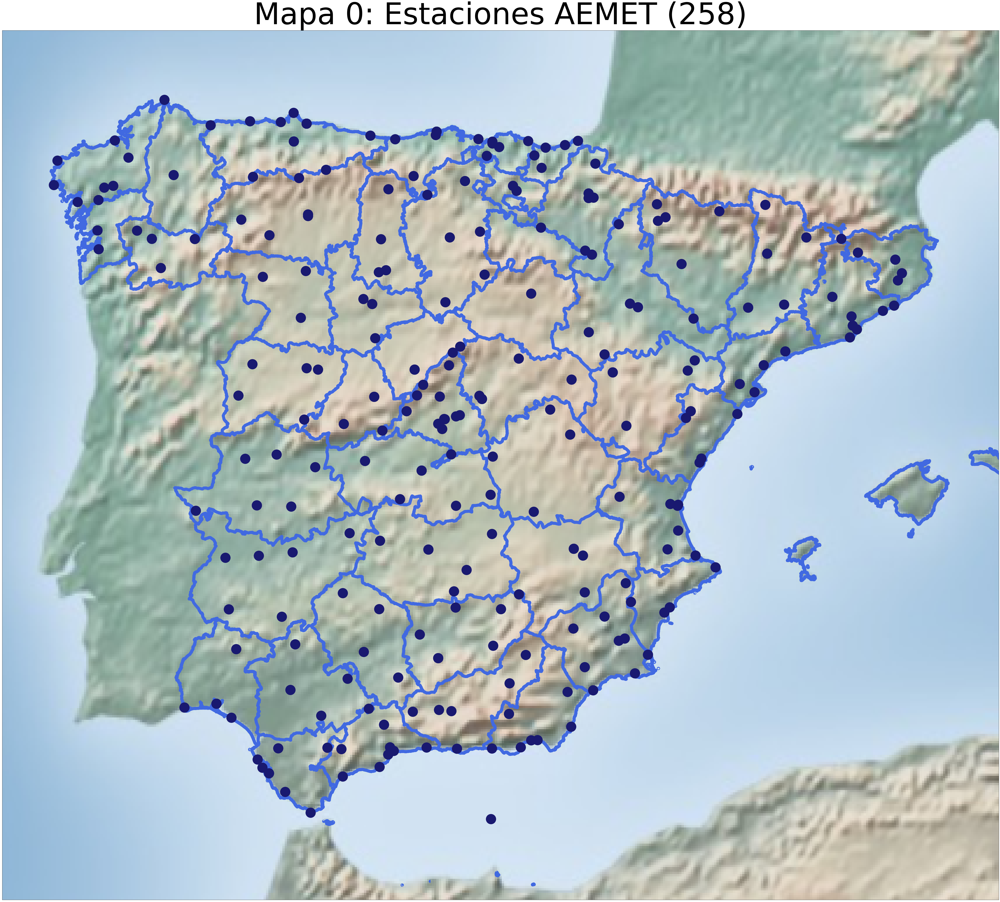

In [77]:
from IPython.display import Image as disp_Image

PATH = "../Data_in/3.3_Climatologia/Comp. vars. climaticas/3.2_Geolocalizacion (GEOPY)/Mapas/"
disp_Image(filename = PATH + "Mapa_0.png", width=600, height=600)

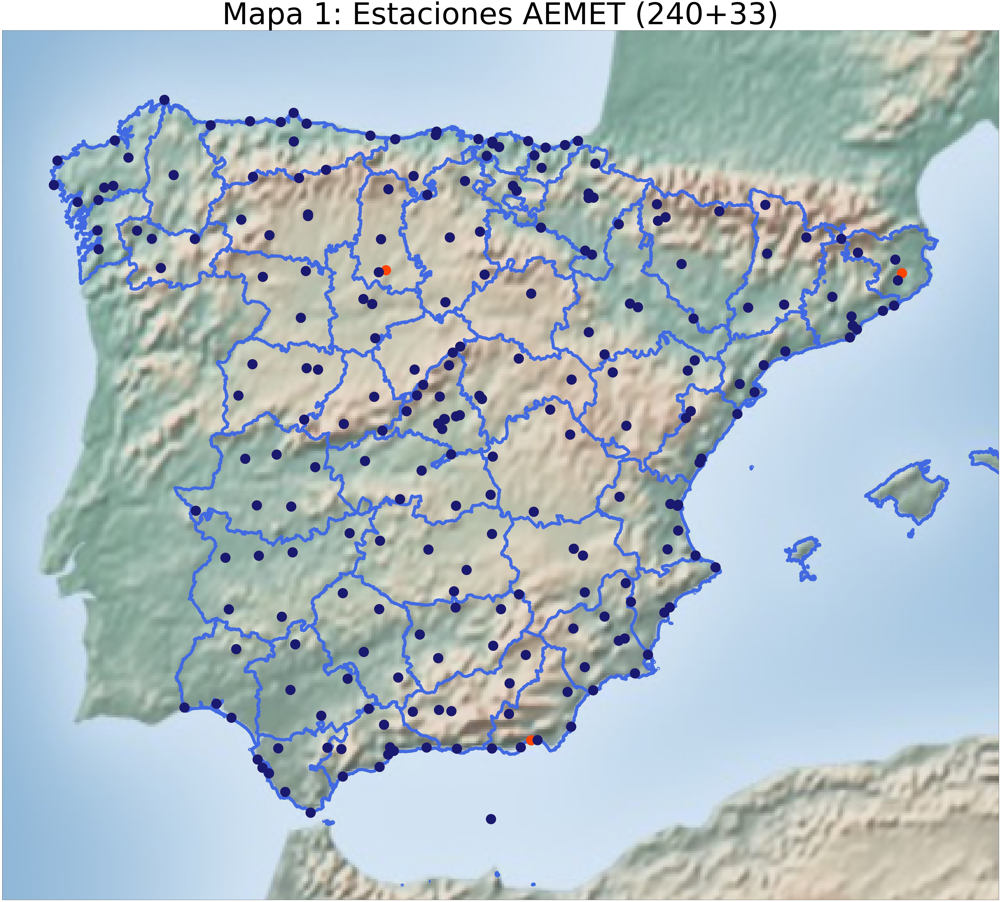

In [78]:
from IPython.display import Image as disp_Image

PATH = "../Data_in/3.3_Climatologia/Comp. vars. climaticas/3.2_Geolocalizacion (GEOPY)/Mapas/"
disp_Image(filename = PATH + "Mapa_1.png", width=600, height=600)

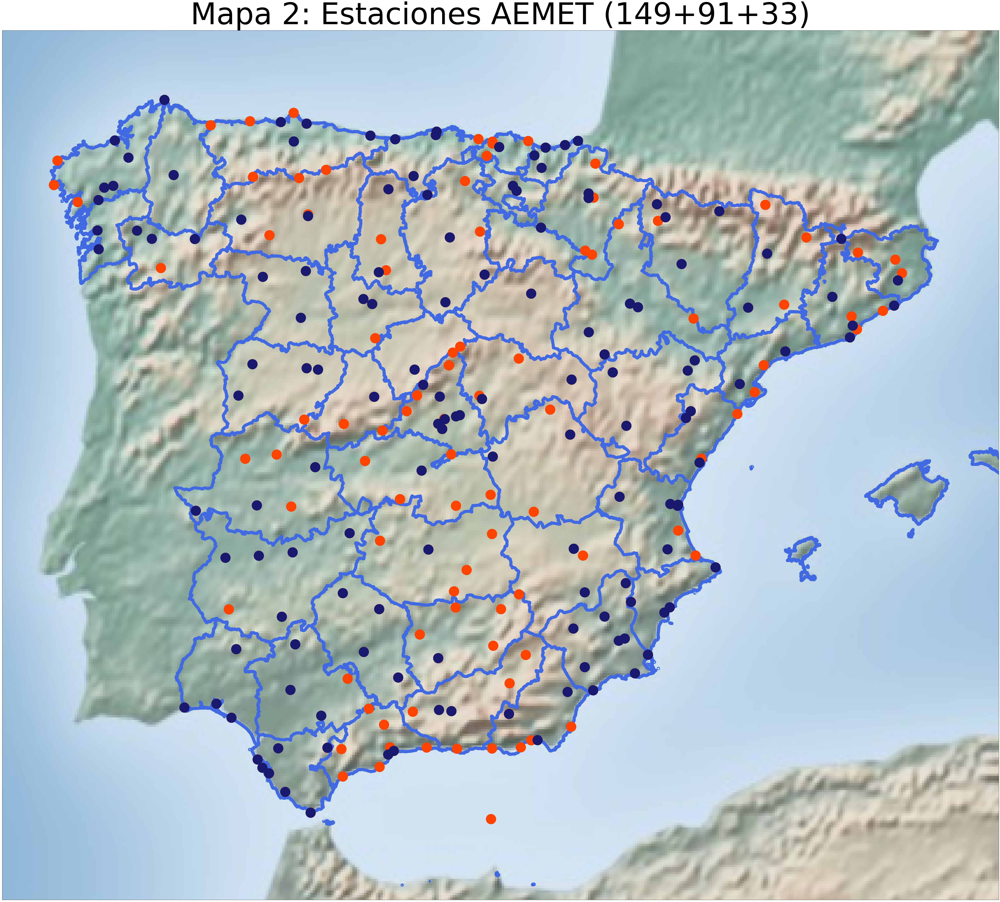

In [79]:
PATH = "../Data_in/3.3_Climatologia/Comp. vars. climaticas/3.2_Geolocalizacion (GEOPY)/Mapas/"
disp_Image(filename = PATH + "Mapa_2.png", width=600, height=600)

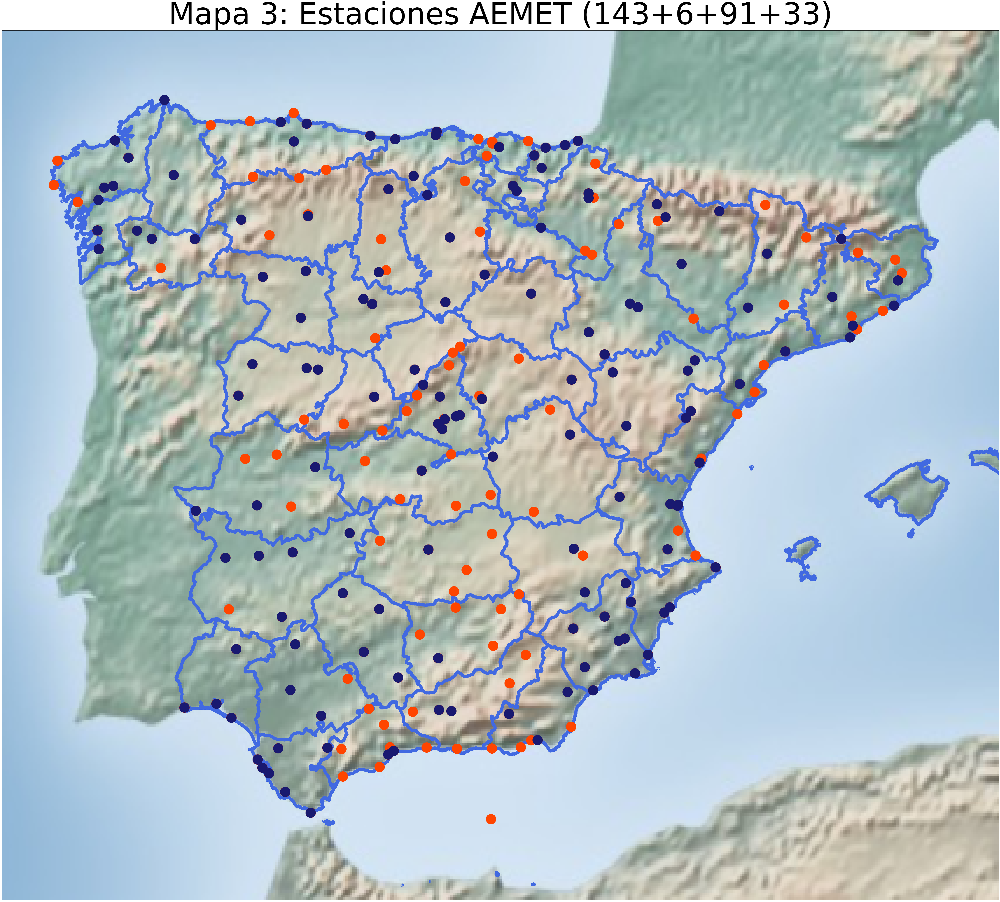

In [80]:
PATH = "../Data_in/3.3_Climatologia/Comp. vars. climaticas/3.2_Geolocalizacion (GEOPY)/Mapas/"
disp_Image(filename = PATH + "Mapa_3.png", width=600, height=600)

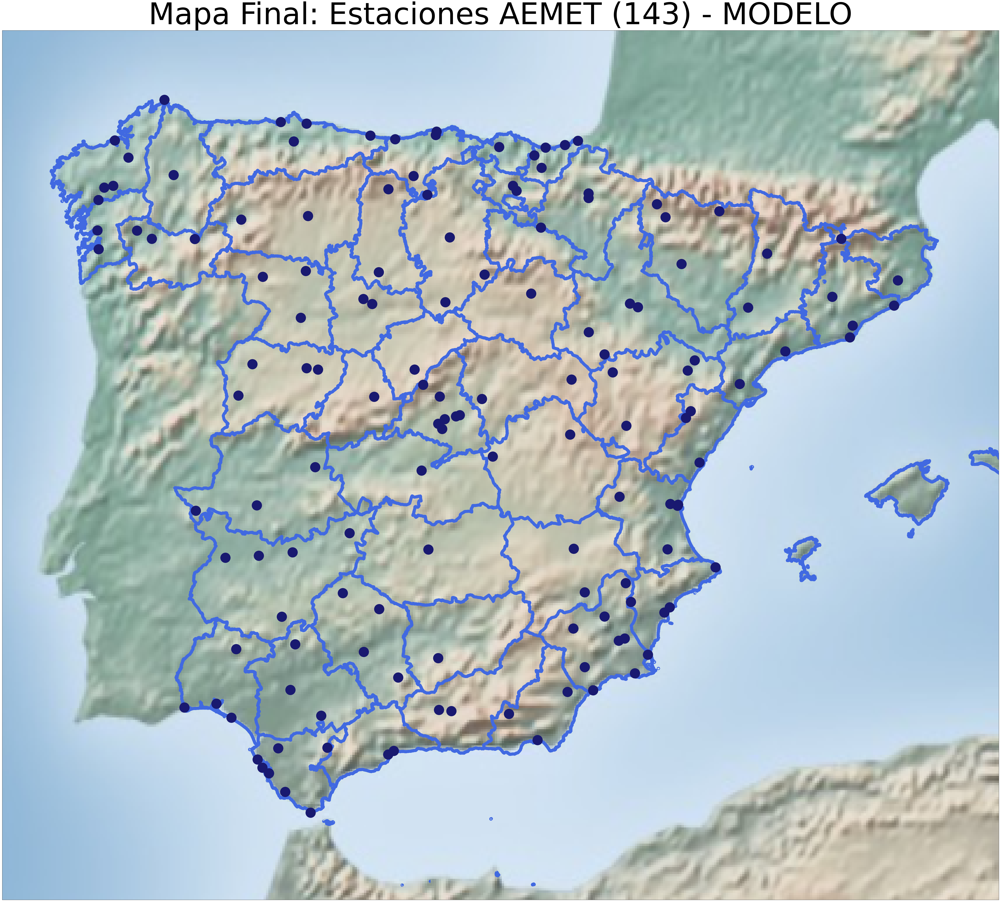

In [81]:
PATH = "../Data_in/3.3_Climatologia/Comp. vars. climaticas/3.2_Geolocalizacion (GEOPY)/Mapas/"
disp_Image(filename = PATH + "_Mapa_F.png", width=600, height=600)

#### - Visualización dinámica (GIF)

In [11]:
import glob
from PIL import Image as pil_Image

def make_gif(frame_folder, out_folder, name_gif):
    frames = [pil_Image.open(image) for image in glob.glob(f"{frame_folder}/*.png")]
    frame_one = frames[0]
    frame_one.save(f"{out_folder}/{name_gif}.gif", format="GIF", append_images=frames,
               save_all=True, duration=2500, loop=0)


In [12]:
data_in = "../Data_in/3.3_Climatologia/Comp. vars. climaticas/3.2_Geolocalizacion (GEOPY)/Mapas/"
data_out = "../Data_out/Comp. vars. climaticas"
name_file = "Análisis Est. AEMET"

In [13]:
if __name__ == "__main__":
    make_gif(data_in, data_out, name_file)

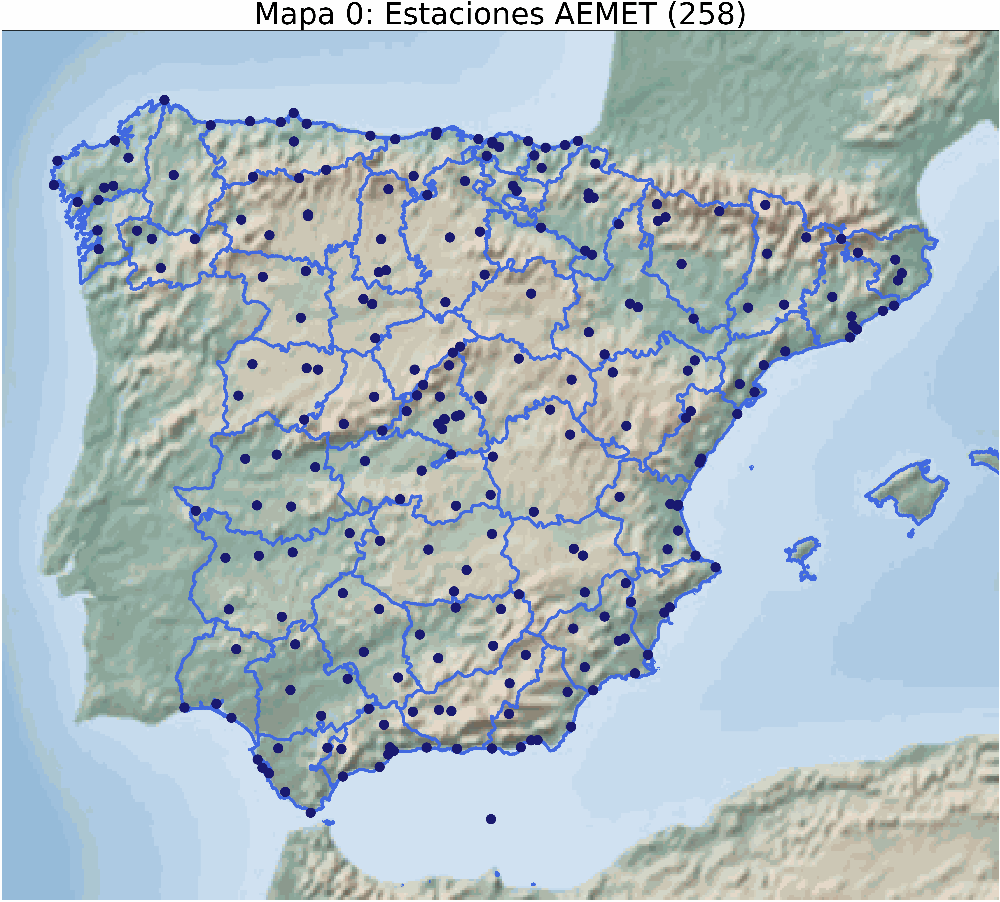

In [14]:
from IPython.display import Image as disp_Image

with open(f"{data_out}/{name_file}.gif",'rb') as file:
    imgs = disp_Image(file.read(), width=750, height=750)
    display(imgs)

Una vez revisada la distribución de estaciones finalmente seleccionadas para el modelo, ésta se considera suficientemente homogénea y repartida por todo el territorio peninsular. Se mantiene la selección de 97 estaciones definidas en los apartados anteriores.

### 3.5. Datos de distancia entre estacione AEMET

Adicionalmente y para su uso posterior en caso necesario se cargan las distancias entre sí de las 97 estaciones AEMET seleccionadas para el modelo.

In [86]:
# CARGA DATOS

data_in6 = "../Data_in/3.3_Climatologia/Comp. vars. climaticas/3.2_Geolocalizacion (GEOPY)/Dist_AEMET-AEMET (149 est).csv"

EstDist_df = pd.read_csv(data_in6, sep=",", header='infer', index_col=None, decimal='.', na_values=np.nan, dtype={'Ind_AEMET':'string'})

In [87]:
EstDist_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 149 entries, 0 to 148
Columns: 150 entries, Ind_AEMET to 9981A
dtypes: float64(149), string(1)
memory usage: 174.7 KB


In [88]:
EstDist_df.describe()

,0076,0367,1014,1082,1109,1111,1159,1351,1387,1428,...,9381I,9394X,9434P,9563X,9569A,9573X,9698U,9771C,9784P,9981A
count,149.000000,149.000000,149.000000,149.000000,149.000000,149.000000,149.000000,149.000000,149.000000,149.000000,...,149.000000,149.000000,149.000000,149.000000,149.000000,149.000000,149.000000,149.000000,149.000000,149.000000
mean,671.345985,749.989077,488.720274,458.162571,464.528796,466.909283,469.434550,653.226993,683.070397,662.335844,...,411.869468,404.400031,443.208681,473.094162,472.929562,481.108091,589.421227,549.519085,556.646938,527.097124
std,297.310517,304.114025,228.697872,213.368420,214.524668,215.111437,216.812872,277.882203,289.742781,289.099256,...,207.489192,198.753871,225.776578,246.332331,245.768477,249.032104,276.442731,270.411558,261.229147,265.313647
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,472.105000,545.642900,331.494100,304.590300,307.565900,311.416500,295.961700,476.891500,505.765300,480.143800,...,265.844200,245.773500,247.215100,286.104300,287.929900,297.685600,372.937800,342.185500,326.665300,324.130800
50%,674.884400,747.119800,484.145700,491.148200,491.854400,495.972000,474.026300,676.999200,702.382000,675.764200,...,382.135700,378.223200,407.393300,431.979600,430.473700,441.471400,553.785700,527.847000,537.740600,498.845300
75%,905.756500,989.640200,664.980000,622.874900,648.830900,649.645600,660.051500,883.754500,915.702200,891.796200,...,571.090300,531.395800,602.685400,692.834600,676.570200,681.808000,798.092300,767.329600,757.636700,758.177100
max,1195.075100,1263.195000,922.099700,861.881300,845.830900,849.932700,828.129600,1174.459600,1244.590000,1241.343300,...,835.575200,788.024900,865.754200,965.977100,950.163800,958.281900,1071.466100,1031.278000,1035.692300,1033.485200


Filtramos las estaciones sin población asignada:

In [89]:
EstDist_df

,Ind_AEMET,0076,0367,1014,1082,1109,1111,1159,1351,1387,...,9381I,9394X,9434P,9563X,9569A,9573X,9698U,9771C,9784P,9981A
0,0076,0.0000,101.3711,486.6253,596.0027,694.3079,694.3072,753.1039,1114.9963,1180.9865,...,375.9243,411.5334,335.9847,266.0871,258.5357,246.1279,163.7054,164.4327,253.8431,182.3635
1,0367,101.3711,0.0000,529.8098,647.1915,747.6156,747.1198,808.9211,1174.4596,1244.5900,...,462.3129,490.9070,410.8769,361.9032,348.0101,333.9712,208.3585,238.3396,292.7214,278.0456
2,1014,486.6253,529.8098,0.0000,124.2669,224.0841,222.8112,287.8420,653.1356,729.7120,...,277.8371,224.7948,216.3720,365.1209,320.9553,316.8026,325.8887,331.4941,237.4129,383.2647
3,1082,596.0027,647.1915,124.2669,0.0000,100.8987,100.1058,164.0326,530.1661,605.7068,...,319.8111,258.7047,287.8531,433.7555,396.7925,397.0823,440.1232,434.7123,354.8600,470.5211
4,1109,694.3079,747.6156,224.0841,100.8987,0.0000,4.1276,64.0381,429.3506,505.7653,...,394.4524,333.6700,376.7342,516.9765,484.0643,486.1880,540.1270,531.7311,455.5508,561.3014
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,9573X,246.1279,333.9712,316.8026,397.0823,486.1880,487.1207,538.4836,889.0970,949.3041,...,129.7964,170.2573,109.5706,61.4302,16.4564,0.0000,170.3484,104.9101,180.4940,76.3704
145,9698U,163.7054,208.3585,325.8887,440.1232,540.1270,539.7587,600.9687,966.2008,1036.2816,...,281.0429,295.9698,213.2301,222.9071,186.8034,170.3484,0.0000,70.3778,90.2571,160.6138
146,9771C,164.4327,238.3396,331.4941,434.7123,531.7311,531.9017,589.6452,950.6726,1016.5962,...,226.6004,252.5917,173.4918,153.3707,121.0597,104.9101,70.3778,0.0000,122.0492,92.0344
147,9784P,253.8431,292.7214,237.4129,354.8600,455.5508,454.9247,517.5258,883.7545,956.1477,...,254.1086,250.3509,171.0393,241.6265,195.0703,180.4940,90.2571,122.0492,0.0000,207.0100


In [90]:
#cols_modelo = ['Ind_AEMET']
#cols_modelo.extend(est_modelo)
#cols_modelo

In [91]:
#EstDist_df = EstDist_df[EstDist_df['Ind_AEMET'].isin(est_modelo)]
#EstDist_df = EstDist_df[est_modelo]

In [92]:
EstDist_df.shape

(149, 150)

## 4. PREP. DATASETS "TRAIN" Y "TEST"

### 4.1. Def. datasets finales para el modelo

In [93]:
ClimaF_df = Clima_df[Clima_df['Ind_AEMET'].isin(est_completas)].copy()
ClimaF_df = ClimaF_df[(ClimaF_df['Fecha']>='2014-01-01') & (ClimaF_df['Fecha']<='2021-12-31')]
ClimaF_df.reset_index(level=None, drop=True, inplace=True, col_level=0, col_fill='')

In [94]:
ClimaF_df

,Fecha,Ind_AEMET,Ind_INE,Provincia,Nombre,Tmax,Tmin
0,2015-01-23,0016A,43907,TARRAGONA,REUS AEROPUERTO,14.1,-1.6
1,2015-01-24,0016A,43907,TARRAGONA,REUS AEROPUERTO,13.4,4.3
2,2015-01-25,0016A,43907,TARRAGONA,REUS AEROPUERTO,14.9,5.3
3,2015-01-26,0016A,43907,TARRAGONA,REUS AEROPUERTO,14.1,-1.6
4,2015-01-27,0016A,43907,TARRAGONA,REUS AEROPUERTO,14.8,2.3
...,...,...,...,...,...,...,...
433271,2021-12-27,0200E,08077,BARCELONA,"BARCELONA, FABRA",17.0,10.3
433272,2021-12-26,0200E,08077,BARCELONA,"BARCELONA, FABRA",16.0,9.8
433273,2021-12-28,0200E,08077,BARCELONA,"BARCELONA, FABRA",16.4,12.1
433274,2021-12-23,0200E,08077,BARCELONA,"BARCELONA, FABRA",11.9,8.9


In [95]:
len(ClimaF_df['Ind_AEMET'].unique())

149

#### - Creamos las observaciones que faltan para cada estación

In [96]:
ClimaF_df.shape[0]

433276

In [97]:
lista_dias = pd.date_range('2014-01-01','2021-12-31',freq='D')
print(len(lista_dias)*len(ClimaF_df['Ind_AEMET'].unique()))

435378


Como se puede observar faltan observaciones en el dataset por lo que habrá que completar todas las observaciones diarias que falten para cada una de las estaciones del dataset.

In [98]:
#ClimaF_df_PRUEBA = ClimaF_df[(ClimaF_df['Fecha']>='2014-01-01') & (ClimaF_df['Fecha']<='2014-12-31')].copy()

In [99]:
#ClimaF_df_PRUEBA[ClimaF_df_PRUEBA['Tmax'].isnull()]

In [100]:
#ClimaF_df_PRUEBA

In [101]:
def compl_obs_est(df_input, col_Fecha, col_IndAEMET, fecha_ini, fecha_fin):
    
    lista_est = list(set(df_input[col_IndAEMET].tolist()))
    lista_dias = pd.date_range(fecha_ini,fecha_fin,freq='D')
    print('Nº estaciones a completar:', len(lista_est))
    print('Nº días a completar:', len(lista_dias))
    
    cols_df = df_input.columns
    df_extra = pd.DataFrame(columns=cols_df)
    i=-1
    
    for x in lista_est:  # estaciones
        
        est_df = df_input[df_input[col_IndAEMET]==x].copy().reset_index(drop=True)

        est_Ind_AEMET = est_df['Ind_AEMET'][0]
        #print(est_Ind_AEMET)
        est_Ind_INE = est_df['Ind_INE'][0]
        est_Provincia = est_df['Provincia'][0]
        est_Nombre = est_df['Nombre'][0]
        
        n_rows = est_df.shape[0]
        
        for y in lista_dias:
            i+=1
        
            if est_df[est_df[col_Fecha]==y].shape[0] == 0:
                #print(y)
                df_extra.at[i,'Fecha'] = y.date()
                df_extra.at[i,'Ind_AEMET'] = est_Ind_AEMET
                df_extra.at[i,'Ind_INE'] = est_Ind_INE
                df_extra.at[i,'Provincia'] = est_Provincia
                df_extra.at[i,'Nombre'] = est_Nombre
                df_extra.at[i,'Tmax'] = np.nan
                df_extra.at[i,'Tmin'] = np.nan
                continue
            else:
                continue
                
    df_out = pd.concat([df_input,df_extra], axis=0)
    df_out[col_Fecha] = pd.to_datetime(df_out[col_Fecha])
    df_out = df_out.sort_values(by=['Fecha','Ind_AEMET']).reset_index(drop=True)
    
    return df_out
        

In [102]:
ClimaF_df = compl_obs_est(df_input=ClimaF_df, col_Fecha='Fecha', col_IndAEMET='Ind_AEMET', 
                          fecha_ini='2014-01-01', fecha_fin='2021-12-31')

Nº estaciones a completar: 149
Nº días a completar: 2922


In [103]:
#ClimaF_df['Fecha'] = pd.to_datetime(ClimaF_df['Fecha'])

In [104]:
ClimaF_df.shape

(435378, 7)

In [105]:
duplicate = Clima_df[Clima_df.duplicated(['Fecha', 'Ind_AEMET'])]
duplicate

,Fecha,Ind_AEMET,Ind_INE,Provincia,Nombre,Tmax,Tmin


In [106]:
lista_dias = pd.date_range('2014-01-01','2021-12-31',freq='D')
print(len(lista_dias)*len(ClimaF_df['Ind_AEMET'].unique()))

435378


Ahora ya tenemos el dataset completo.

In [107]:
#ClimaF_df = ClimaF_df.sort_values(by=['Fecha','Ind_AEMET']).reset_index(drop=True)

In [108]:
ClimaF_df

,Fecha,Ind_AEMET,Ind_INE,Provincia,Nombre,Tmax,Tmin
0,2014-01-01,0016A,43907,TARRAGONA,REUS AEROPUERTO,15.6,3.3
1,2014-01-01,0076,08169,BARCELONA,BARCELONA AEROPUERTO,14.5,4.7
2,2014-01-01,0149X,08113,BARCELONA,MANRESA,12.0,-1.7
3,2014-01-01,0200E,08077,BARCELONA,"BARCELONA, FABRA",14.1,6.2
4,2014-01-01,0255B,08261,BARCELONA,SANTA SUSANNA,13.2,1.9
...,...,...,...,...,...,...,...
435373,2021-12-31,9698U,25215,LLEIDA,TALARN,15.6,4.6
435374,2021-12-31,9771C,25120,LLEIDA,LLEIDA,6.6,2.6
435375,2021-12-31,9784P,22057,HUESCA,BIELSA,13.8,1.9
435376,2021-12-31,9898,22015,HUESCA,"HUESCA, AEROPUERTO",14.6,6.5


A su vez y previamente al tratamiento de "missing values", dividimos los datos en los subconjuntos de "train" y "test":

In [109]:
ClimaTrain_df = ClimaF_df[ClimaF_df['Fecha']<'2021-01-01'].copy()
ClimaTrain_df.reset_index(level=None, drop=True, inplace=True, col_level=0, col_fill='')
ClimaTrain_df

,Fecha,Ind_AEMET,Ind_INE,Provincia,Nombre,Tmax,Tmin
0,2014-01-01,0016A,43907,TARRAGONA,REUS AEROPUERTO,15.6,3.3
1,2014-01-01,0076,08169,BARCELONA,BARCELONA AEROPUERTO,14.5,4.7
2,2014-01-01,0149X,08113,BARCELONA,MANRESA,12.0,-1.7
3,2014-01-01,0200E,08077,BARCELONA,"BARCELONA, FABRA",14.1,6.2
4,2014-01-01,0255B,08261,BARCELONA,SANTA SUSANNA,13.2,1.9
...,...,...,...,...,...,...,...
380988,2020-12-31,9698U,25215,LLEIDA,TALARN,7.3,-3.2
380989,2020-12-31,9771C,25120,LLEIDA,LLEIDA,9.9,-1.8
380990,2020-12-31,9784P,22057,HUESCA,BIELSA,3.8,-5.1
380991,2020-12-31,9898,22015,HUESCA,"HUESCA, AEROPUERTO",8.1,-0.6


In [110]:
ClimaTest_df = ClimaF_df[ClimaF_df['Fecha']>='2021-01-01'].copy()
ClimaTest_df.reset_index(level=None, drop=True, inplace=True, col_level=0, col_fill='')
ClimaTest_df

,Fecha,Ind_AEMET,Ind_INE,Provincia,Nombre,Tmax,Tmin
0,2021-01-01,0016A,43907,TARRAGONA,REUS AEROPUERTO,11.6,2.5
1,2021-01-01,0076,08169,BARCELONA,BARCELONA AEROPUERTO,8.5,5.3
2,2021-01-01,0149X,08113,BARCELONA,MANRESA,7.9,0.5
3,2021-01-01,0200E,08077,BARCELONA,"BARCELONA, FABRA",6.6,3.3
4,2021-01-01,0255B,08261,BARCELONA,SANTA SUSANNA,9.4,0.8
...,...,...,...,...,...,...,...
54380,2021-12-31,9698U,25215,LLEIDA,TALARN,15.6,4.6
54381,2021-12-31,9771C,25120,LLEIDA,LLEIDA,6.6,2.6
54382,2021-12-31,9784P,22057,HUESCA,BIELSA,13.8,1.9
54383,2021-12-31,9898,22015,HUESCA,"HUESCA, AEROPUERTO",14.6,6.5


### 4.2. Análisis previo del dataset "train"

Realizamos un breve análisis previo de los datos de entrenamiento:

In [111]:
ClimaTrain_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 380993 entries, 0 to 380992
Data columns (total 7 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   Fecha      380993 non-null  datetime64[ns]
 1   Ind_AEMET  380993 non-null  object        
 2   Ind_INE    380993 non-null  object        
 3   Provincia  380993 non-null  object        
 4   Nombre     380993 non-null  object        
 5   Tmax       376420 non-null  float64       
 6   Tmin       376306 non-null  float64       
dtypes: datetime64[ns](1), float64(2), object(4)
memory usage: 20.3+ MB


In [112]:
ClimaTrain_df.describe()

,Tmax,Tmin
count,376420.000000,376306.000000
mean,21.079706,9.892821
std,7.951652,6.518277
min,-8.100000,-15.600000
25%,15.100000,5.200000
50%,20.500000,9.900000
75%,27.000000,14.700000
max,46.900000,29.800000


In [113]:
import pandas_profiling
profile = pandas_profiling.ProfileReport(ClimaTrain_df, title='ClimaTrain_TFM', explorative=True)
# profile.to_notebook_iframe()
profile.to_file('../Data_out/Comp. vars. climaticas/ClimaTrain_TFM.html')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Revisamos los "missing values" del dataset:

In [114]:
ClimaTrain_nan = nan_estaciones(ClimaTrain_df,'Ind_AEMET', ini_datos='2014-01-01', fin_datos='2020-12-31')
ClimaTrain_nan

,Fecha,Ind_AEMET,Ind_INE,Provincia,Nombre,Tmax,Tmin,N_obs,N_miss,%_miss,Fecha_min,Fecha_max
0,0,9208E,0,0,0,138,138,2557,138,0.053969,2014-01-01 00:00:00,2020-12-31 00:00:00
1,0,9394X,0,0,0,52,52,2557,52,0.020336,2014-01-01 00:00:00,2020-12-31 00:00:00
2,0,0016A,0,0,0,122,123,2557,123,0.048103,2014-01-01 00:00:00,2020-12-31 00:00:00
3,0,8368U,0,0,0,0,0,2557,0,0.0,2014-01-01 00:00:00,2020-12-31 00:00:00
4,0,5514,0,0,0,1,0,2557,1,0.000391,2014-01-01 00:00:00,2020-12-31 00:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...
144,0,1387E,0,0,0,17,17,2557,17,0.006648,2014-01-01 00:00:00,2020-12-31 00:00:00
145,0,3168D,0,0,0,1,1,2557,1,0.000391,2014-01-01 00:00:00,2020-12-31 00:00:00
146,0,8489X,0,0,0,59,59,2557,59,0.023074,2014-01-01 00:00:00,2020-12-31 00:00:00
147,0,7247X,0,0,0,64,64,2557,64,0.025029,2014-01-01 00:00:00,2020-12-31 00:00:00


In [115]:
Tmax_nan = ClimaTrain_nan[ClimaTrain_nan['%_miss']>=0.025]
print(Tmax_nan.shape)
Tmax_nan

(28, 12)


,Fecha,Ind_AEMET,Ind_INE,Provincia,Nombre,Tmax,Tmin,N_obs,N_miss,%_miss,Fecha_min,Fecha_max
0,0,9208E,0,0,0,138,138,2557,138,0.053969,2014-01-01 00:00:00,2020-12-31 00:00:00
2,0,0016A,0,0,0,122,123,2557,123,0.048103,2014-01-01 00:00:00,2020-12-31 00:00:00
7,0,1183X,0,0,0,116,116,2557,116,0.045366,2014-01-01 00:00:00,2020-12-31 00:00:00
15,0,8293X,0,0,0,87,87,2557,87,0.034024,2014-01-01 00:00:00,2020-12-31 00:00:00
30,0,5427X,0,0,0,129,129,2557,129,0.05045,2014-01-01 00:00:00,2020-12-31 00:00:00
40,0,7096B,0,0,0,126,126,2557,126,0.049276,2014-01-01 00:00:00,2020-12-31 00:00:00
45,0,9563X,0,0,0,79,79,2557,79,0.030896,2014-01-01 00:00:00,2020-12-31 00:00:00
50,0,9201K,0,0,0,119,119,2557,119,0.046539,2014-01-01 00:00:00,2020-12-31 00:00:00
52,0,6001,0,0,0,108,108,2557,108,0.042237,2014-01-01 00:00:00,2020-12-31 00:00:00
55,0,9784P,0,0,0,68,68,2557,68,0.026594,2014-01-01 00:00:00,2020-12-31 00:00:00


Dado que es un número reducido de "missing values" y se cuenta con un dataset de tamaño suficiente, se decide tratarlos utilizando el método "Multiple Imputation by Chained Equations (MICE)" de imputación de valores.

## 5. TRATAMIENTO DE "MISSING VALUES"

Procedimiento de preparación de datos y aplicación del método "Multiple Imputation by Chained Equations (MICE)" de imputación de valores.

### 5.1. Encoding previo a imputación de valores

Antes de realizar la imputación de valores y para que el algoritmo MICE funcione correctamente es necesario realizar un ajuste previo de las variables del dataset. Se realizarán las siguientes modificaciones en el dataset:

   - Retiramos las columnas 'Ind_INE','Provincia' y 'Nombre', ya que no aportan información nueva que no esté definida en el código identificatico de la propia estación.
   
   - Añadimos las variables 'Longitude' y 'Latitude', variables de las coordenadas de las estaciones que pueden aportar información relevante al algoritmo de imputación.
   
   - Descomponemos la variable 'Fecha' para poder codificarla de manera correcta.
   
   - Codificamos las variables categóricas 'Fecha' e 'Ind_AEMET'.
   
El proceso de "encoding" se va a realizar al dataset completo de datos climáticos ("train" y "test"), ya que va a ser necesario para ambos y no afecta en ningún caso a los datos. Posteriormente cuando se realice la imputación de valores si se separarán, imputando primero valores en el dataset de "train" y posteriormente imputando los valores restantes del dataset de "test" con ambos datasets unidos: "train" y "test".

#### - Retiramos las columnas 'Ind_INE', 'Provincia' y 'Nombre'

In [116]:
drop_list = ['Ind_INE','Provincia','Nombre']

ClimaF_df = ClimaF_df.drop(axis=1, columns=drop_list, level=None, inplace=False, errors='raise')

In [117]:
ClimaF_df

,Fecha,Ind_AEMET,Tmax,Tmin
0,2014-01-01,0016A,15.6,3.3
1,2014-01-01,0076,14.5,4.7
2,2014-01-01,0149X,12.0,-1.7
3,2014-01-01,0200E,14.1,6.2
4,2014-01-01,0255B,13.2,1.9
...,...,...,...,...
435373,2021-12-31,9698U,15.6,4.6
435374,2021-12-31,9771C,6.6,2.6
435375,2021-12-31,9784P,13.8,1.9
435376,2021-12-31,9898,14.6,6.5


#### - Añadimos las variables 'Longitude', 'Latitude' y distancias relativas entre estaciones

In [118]:
# Añadimos información adicional de cada estación a sus observaciones correspondientes:

ClimaF_df = pd.merge(ClimaF_df, EstCoord_df, how="left",on='Ind_AEMET', suffixes=None,sort=False)
ClimaF_df = pd.merge(ClimaF_df, EstDist_df, how="left",on='Ind_AEMET', suffixes=None,sort=False)

<ipython-input-118-c9342d7d3320>:3: FutureWarning: Passing 'suffixes' as a <class 'NoneType'>, is not supported and may give unexpected results. Provide 'suffixes' as a tuple instead. In the future a 'TypeError' will be raised.
  ClimaF_df = pd.merge(ClimaF_df, EstCoord_df, how="left",on='Ind_AEMET', suffixes=None,sort=False)
<ipython-input-118-c9342d7d3320>:4: FutureWarning: Passing 'suffixes' as a <class 'NoneType'>, is not supported and may give unexpected results. Provide 'suffixes' as a tuple instead. In the future a 'TypeError' will be raised.
  ClimaF_df = pd.merge(ClimaF_df, EstDist_df, how="left",on='Ind_AEMET', suffixes=None,sort=False)


In [119]:
ClimaF_df

,Fecha,Ind_AEMET,Tmax,Tmin,Longitude,Latitude,0076,0367,1014,1082,...,9381I,9394X,9434P,9563X,9569A,9573X,9698U,9771C,9784P,9981A
0,2014-01-01,0016A,15.6,3.3,1.157435,41.146412,103.2748,196.4929,409.6823,510.6054,...,272.8347,310.4300,238.0361,165.4117,155.2667,143.0852,119.1740,78.4886,195.3776,81.6375
1,2014-01-01,0076,14.5,4.7,2.079047,41.296944,0.0000,101.3711,486.6253,596.0027,...,375.9243,411.5334,335.9847,266.0871,258.5357,246.1279,163.7054,164.4327,253.8431,182.3635
2,2014-01-01,0149X,12.0,-1.7,1.828677,41.728894,55.4607,105.0816,440.4508,553.3969,...,357.4184,386.0781,306.6375,261.7289,244.1380,229.6823,114.6459,133.5047,204.5084,179.0991
3,2014-01-01,0200E,14.1,6.2,2.118914,41.422368,14.6447,89.0680,484.1457,595.0805,...,382.1357,416.0052,339.2235,275.1736,265.4030,252.4585,159.4111,166.4134,249.6534,191.2342
4,2014-01-01,0255B,13.2,1.9,2.706593,41.635726,78.9620,30.5164,533.9885,649.1011,...,450.0727,481.9082,403.4716,344.2903,333.9625,320.6716,208.9869,229.9874,296.6450,260.3654
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
435373,2021-12-31,9698U,15.6,4.6,0.899531,42.186035,163.7054,208.3585,325.8887,440.1232,...,281.0429,295.9698,213.2301,222.9071,186.8034,170.3484,0.0000,70.3778,90.2571,160.6138
435374,2021-12-31,9771C,6.6,2.6,0.626784,41.614761,164.4327,238.3396,331.4941,434.7123,...,226.6004,252.5917,173.4918,153.3707,121.0597,104.9101,70.3778,0.0000,122.0492,92.0344
435375,2021-12-31,9784P,13.8,1.9,0.218859,42.633555,253.8431,292.7214,237.4129,354.8600,...,254.1086,250.3509,171.0393,241.6265,195.0703,180.4940,90.2571,122.0492,0.0000,207.0100
435376,2021-12-31,9898,14.6,6.5,-0.319546,42.077236,279.0801,341.3309,217.5069,318.1033,...,168.3297,167.0171,85.7324,176.0068,127.0630,116.1690,135.3416,116.6184,85.9037,169.4643


#### - Descomponemos la variable 'Fecha'

Dado que el algoritmo de MICE no acepta variables categóricas hay que codificarlas. 

En el caso de la variable "Ind_AEMET" (código de cada estación), esta codificación se puede realizar directamente utilizando la herramienta "One Hot Encoder", no así la variable "Fecha" ya que en caso de utilizar el mismo procedimiento ("One Hot Encoder"), crearíamos 1096 nuevas columnas (orden muy grande) y perderíamos parte de la infomación recogida en la variable ya que el algoritmo no tendría en cuenta los posibles efectos estacionales.

Por ello para la variable "Fecha" se decide desagregar las fechas en 3 nuevas variables: "Year", "Month" y "Day". La primera se va a considerar como una variable numérica directamente ya que el orden de los años es lineal pero las dos siguientes ("Month" y "Day") se van a considerar como categóricas, codificándolas ahora sí con la herramienta "One Hot Encoder". De esta manera permitimos al algoritmo MICE que vea los posibles efectos estacionales entre las observaciones.

In [120]:
# Definimos función para descomponer la variable

def descomp_fecha(df_input, col_fecha, col_drop=None):
    
    df_out = df_input.copy()
    df_out['N_ano'] = np.nan
    df_out['N_mes'] = np.nan
    df_out['N_dia_mes'] = np.nan
    
    nrows = df_input.shape[0]
    
    for i in range(0,nrows):
        year = int(df_input[col_fecha][i].date().year)
        month = int(df_input[col_fecha][i].date().month)
        day = int(df_input[col_fecha][i].date().day)
        
        try:
            df_out.at[i, 'N_ano'] = year
            df_out.at[i, 'N_mes'] = month
            df_out.at[i, 'N_dia_mes'] = day
        except:
            continue
    
    df_out = df_out.astype({'N_ano':'int64','N_mes':'int64','N_dia_mes':'int64'})
    #df_out = df_out.astype({'N_mes':'string','N_dia_mes':'string'})
    
    if col_drop!=None:
        df_out.drop(axis=1, columns=col_drop, level=None, inplace=True, errors='raise')
            
    return df_out


In [121]:
ClimaF_df = descomp_fecha(ClimaF_df,'Fecha')

In [122]:
ClimaF_df

,Fecha,Ind_AEMET,Tmax,Tmin,Longitude,Latitude,0076,0367,1014,1082,...,9563X,9569A,9573X,9698U,9771C,9784P,9981A,N_ano,N_mes,N_dia_mes
0,2014-01-01,0016A,15.6,3.3,1.157435,41.146412,103.2748,196.4929,409.6823,510.6054,...,165.4117,155.2667,143.0852,119.1740,78.4886,195.3776,81.6375,2014,1,1
1,2014-01-01,0076,14.5,4.7,2.079047,41.296944,0.0000,101.3711,486.6253,596.0027,...,266.0871,258.5357,246.1279,163.7054,164.4327,253.8431,182.3635,2014,1,1
2,2014-01-01,0149X,12.0,-1.7,1.828677,41.728894,55.4607,105.0816,440.4508,553.3969,...,261.7289,244.1380,229.6823,114.6459,133.5047,204.5084,179.0991,2014,1,1
3,2014-01-01,0200E,14.1,6.2,2.118914,41.422368,14.6447,89.0680,484.1457,595.0805,...,275.1736,265.4030,252.4585,159.4111,166.4134,249.6534,191.2342,2014,1,1
4,2014-01-01,0255B,13.2,1.9,2.706593,41.635726,78.9620,30.5164,533.9885,649.1011,...,344.2903,333.9625,320.6716,208.9869,229.9874,296.6450,260.3654,2014,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
435373,2021-12-31,9698U,15.6,4.6,0.899531,42.186035,163.7054,208.3585,325.8887,440.1232,...,222.9071,186.8034,170.3484,0.0000,70.3778,90.2571,160.6138,2021,12,31
435374,2021-12-31,9771C,6.6,2.6,0.626784,41.614761,164.4327,238.3396,331.4941,434.7123,...,153.3707,121.0597,104.9101,70.3778,0.0000,122.0492,92.0344,2021,12,31
435375,2021-12-31,9784P,13.8,1.9,0.218859,42.633555,253.8431,292.7214,237.4129,354.8600,...,241.6265,195.0703,180.4940,90.2571,122.0492,0.0000,207.0100,2021,12,31
435376,2021-12-31,9898,14.6,6.5,-0.319546,42.077236,279.0801,341.3309,217.5069,318.1033,...,176.0068,127.0630,116.1690,135.3416,116.6184,85.9037,169.4643,2021,12,31


In [123]:
ClimaF_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 435378 entries, 0 to 435377
Columns: 158 entries, Fecha to N_dia_mes
dtypes: datetime64[ns](1), float64(153), int64(3), object(1)
memory usage: 544.3+ MB


#### - Codificamos las variables categóricas cíclicas 'N_dia_mes' (Day) y 'N_mes'

Codificamos las variables categóricas cíclicas expresándolas mediante los valores del coseno y el seno de la división de una circunferencia por el número de categorías de la variable.

The CyclicalTransformer() works only with numerical variables. A list of variables to transform can be passed as an argument. Alternatively, the transformer will automatically select and transform all numerical variables.
Missing data should be imputed before applying this transformer.

var_sin = sin(variable * (2. * pi / max_value))

var_cos = cos(variable * (2. * pi / max_value))

In [124]:
def cicl_tranf_day(df_input, col_day, col_month, col_ano):
    
    nrows = df_input.shape[0]
    df_out = df_input.copy()
    df_out["N_dia_mes_SIN"] = ""
    df_out["N_dia_mes_COS"] = ""
    
    for i in range(0,nrows):
        day_i = df_input[col_day][i]
        month_i = df_input[col_month][i]
        ano_i = df_input[col_ano][i]
        
        month_31 = [1,3,5,7,8,10,12]
        month_30 = [4,6,9,11]
        month_28_29 = [2]
        
        ano_29 = []
        for x in range(2012,2500,4):
            ano_29.append(x)
        
        if month_i in month_31:
            df_out.at[i, 'N_dia_mes_SIN'] = np.sin((day_i-1)*(2.*np.pi/31))
            df_out.at[i, 'N_dia_mes_COS'] = np.cos((day_i-1)*(2.*np.pi/31))
        if month_i in month_30:
            df_out.at[i, 'N_dia_mes_SIN'] = np.sin((day_i-1)*(2.*np.pi/30))
            df_out.at[i, 'N_dia_mes_COS'] = np.cos((day_i-1)*(2.*np.pi/30))        
        if month_i in month_28_29 and ano_i not in ano_29:
            df_out.at[i, 'N_dia_mes_SIN'] = np.sin((day_i-1)*(2.*np.pi/28))
            df_out.at[i, 'N_dia_mes_COS'] = np.cos((day_i-1)*(2.*np.pi/28))
        if month_i in month_28_29 and ano_i in ano_29:
            df_out.at[i, 'N_dia_mes_SIN'] = np.sin((day_i-1)*(2.*np.pi/29))
            df_out.at[i, 'N_dia_mes_COS'] = np.cos((day_i-1)*(2.*np.pi/29))
            
    df_out = df_out.astype({'N_dia_mes_SIN':'float64', 'N_dia_mes_COS':'float64'})

    return df_out

In [125]:
ClimaF_df = cicl_tranf_day(df_input=ClimaF_df, col_day='N_dia_mes', col_month='N_mes', col_ano='N_ano')

In [126]:
def cicl_tranf_month(df_input, col_month):
    
    nrows = df_input.shape[0]
    df_out = df_input.copy()
    df_out["N_mes_SIN"] = ""
    df_out["N_mes_COS"] = ""
    
    for i in range(0,nrows):
        month_i = df_input[col_month][i]

        df_out.at[i, 'N_mes_SIN'] = np.sin((month_i-1)*(2.*np.pi/12))
        df_out.at[i, 'N_mes_COS'] = np.cos((month_i-1)*(2.*np.pi/12))
            
    df_out = df_out.astype({'N_mes_SIN':'float64', 'N_mes_COS':'float64'})

    return df_out

In [127]:
ClimaF_df = cicl_tranf_month(df_input=ClimaF_df, col_month='N_mes')

In [128]:
ClimaF_df

,Fecha,Ind_AEMET,Tmax,Tmin,Longitude,Latitude,0076,0367,1014,1082,...,9771C,9784P,9981A,N_ano,N_mes,N_dia_mes,N_dia_mes_SIN,N_dia_mes_COS,N_mes_SIN,N_mes_COS
0,2014-01-01,0016A,15.6,3.3,1.157435,41.146412,103.2748,196.4929,409.6823,510.6054,...,78.4886,195.3776,81.6375,2014,1,1,0.000000,1.00000,0.0,1.000000
1,2014-01-01,0076,14.5,4.7,2.079047,41.296944,0.0000,101.3711,486.6253,596.0027,...,164.4327,253.8431,182.3635,2014,1,1,0.000000,1.00000,0.0,1.000000
2,2014-01-01,0149X,12.0,-1.7,1.828677,41.728894,55.4607,105.0816,440.4508,553.3969,...,133.5047,204.5084,179.0991,2014,1,1,0.000000,1.00000,0.0,1.000000
3,2014-01-01,0200E,14.1,6.2,2.118914,41.422368,14.6447,89.0680,484.1457,595.0805,...,166.4134,249.6534,191.2342,2014,1,1,0.000000,1.00000,0.0,1.000000
4,2014-01-01,0255B,13.2,1.9,2.706593,41.635726,78.9620,30.5164,533.9885,649.1011,...,229.9874,296.6450,260.3654,2014,1,1,0.000000,1.00000,0.0,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
435373,2021-12-31,9698U,15.6,4.6,0.899531,42.186035,163.7054,208.3585,325.8887,440.1232,...,70.3778,90.2571,160.6138,2021,12,31,-0.201299,0.97953,-0.5,0.866025
435374,2021-12-31,9771C,6.6,2.6,0.626784,41.614761,164.4327,238.3396,331.4941,434.7123,...,0.0000,122.0492,92.0344,2021,12,31,-0.201299,0.97953,-0.5,0.866025
435375,2021-12-31,9784P,13.8,1.9,0.218859,42.633555,253.8431,292.7214,237.4129,354.8600,...,122.0492,0.0000,207.0100,2021,12,31,-0.201299,0.97953,-0.5,0.866025
435376,2021-12-31,9898,14.6,6.5,-0.319546,42.077236,279.0801,341.3309,217.5069,318.1033,...,116.6184,85.9037,169.4643,2021,12,31,-0.201299,0.97953,-0.5,0.866025


In [129]:
mes_diames_df = ClimaF_df[['N_mes','N_dia_mes']]
mes_diames_df

,N_mes,N_dia_mes
0,1,1
1,1,1
2,1,1
3,1,1
4,1,1
...,...,...
435373,12,31
435374,12,31
435375,12,31
435376,12,31


In [130]:
drop_list = ['N_mes','N_dia_mes']

ClimaF_df = ClimaF_df.drop(axis=1, columns=drop_list, level=None, inplace=False, errors='raise')

In [131]:
ClimaF_df 

,Fecha,Ind_AEMET,Tmax,Tmin,Longitude,Latitude,0076,0367,1014,1082,...,9573X,9698U,9771C,9784P,9981A,N_ano,N_dia_mes_SIN,N_dia_mes_COS,N_mes_SIN,N_mes_COS
0,2014-01-01,0016A,15.6,3.3,1.157435,41.146412,103.2748,196.4929,409.6823,510.6054,...,143.0852,119.1740,78.4886,195.3776,81.6375,2014,0.000000,1.00000,0.0,1.000000
1,2014-01-01,0076,14.5,4.7,2.079047,41.296944,0.0000,101.3711,486.6253,596.0027,...,246.1279,163.7054,164.4327,253.8431,182.3635,2014,0.000000,1.00000,0.0,1.000000
2,2014-01-01,0149X,12.0,-1.7,1.828677,41.728894,55.4607,105.0816,440.4508,553.3969,...,229.6823,114.6459,133.5047,204.5084,179.0991,2014,0.000000,1.00000,0.0,1.000000
3,2014-01-01,0200E,14.1,6.2,2.118914,41.422368,14.6447,89.0680,484.1457,595.0805,...,252.4585,159.4111,166.4134,249.6534,191.2342,2014,0.000000,1.00000,0.0,1.000000
4,2014-01-01,0255B,13.2,1.9,2.706593,41.635726,78.9620,30.5164,533.9885,649.1011,...,320.6716,208.9869,229.9874,296.6450,260.3654,2014,0.000000,1.00000,0.0,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
435373,2021-12-31,9698U,15.6,4.6,0.899531,42.186035,163.7054,208.3585,325.8887,440.1232,...,170.3484,0.0000,70.3778,90.2571,160.6138,2021,-0.201299,0.97953,-0.5,0.866025
435374,2021-12-31,9771C,6.6,2.6,0.626784,41.614761,164.4327,238.3396,331.4941,434.7123,...,104.9101,70.3778,0.0000,122.0492,92.0344,2021,-0.201299,0.97953,-0.5,0.866025
435375,2021-12-31,9784P,13.8,1.9,0.218859,42.633555,253.8431,292.7214,237.4129,354.8600,...,180.4940,90.2571,122.0492,0.0000,207.0100,2021,-0.201299,0.97953,-0.5,0.866025
435376,2021-12-31,9898,14.6,6.5,-0.319546,42.077236,279.0801,341.3309,217.5069,318.1033,...,116.1690,135.3416,116.6184,85.9037,169.4643,2021,-0.201299,0.97953,-0.5,0.866025


#### - Codificamos la variable categórica 'Ind_AEMET'

Realizamos la codificación de las variables categóricas previa a la aplicación del algoritmo MICE. Para ello se emplea la herramienta "One Hot Encoder" de la librería Scikit Learn.

In [132]:
from sklearn.preprocessing import OneHotEncoder

# creating instance of one-hot-encoder
enc_OH = OneHotEncoder(categories='auto', drop=None, sparse=True, dtype='float64', handle_unknown='error')

In [133]:
enc_df = pd.DataFrame(enc_OH.fit_transform(ClimaF_df[['Ind_AEMET']]).toarray())

In [134]:
enc_df.columns = enc_OH.get_feature_names(['Ind_AEMET'])

In [135]:
enc_df

,Ind_AEMET_0016A,Ind_AEMET_0076,Ind_AEMET_0149X,Ind_AEMET_0200E,Ind_AEMET_0255B,Ind_AEMET_0367,Ind_AEMET_1014,Ind_AEMET_1014A,Ind_AEMET_1024E,Ind_AEMET_1037Y,...,Ind_AEMET_9434P,Ind_AEMET_9563X,Ind_AEMET_9569A,Ind_AEMET_9573X,Ind_AEMET_9585,Ind_AEMET_9698U,Ind_AEMET_9771C,Ind_AEMET_9784P,Ind_AEMET_9898,Ind_AEMET_9981A
0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
435373,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
435374,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
435375,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
435376,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [136]:
enc_OH.categories_

[array(['0016A', '0076', '0149X', '0200E', '0255B', '0367', '1014',
        '1014A', '1024E', '1037Y', '1041A', '1050J', '1082', '1109',
        '1111', '1111X', '1159', '1183X', '1207U', '1208H', '1212E',
        '1249I', '1249X', '1351', '1387', '1387E', '1428', '1473A',
        '1475X', '1484C', '1495', '1505', '1549', '1631E', '1690A',
        '1700X', '2030', '2117D', '2235U', '2298', '2331', '2400E', '2422',
        '2444', '2462', '2465', '2539', '2614', '2661', '2755X', '2775X',
        '2867', '2870', '2916A', '2946X', '3013', '3094B', '3129', '3168D',
        '3175', '3191E', '3195', '3196', '3200', '3260B', '3434X', '3469A',
        '3576X', '4121', '4244X', '4267X', '4358X', '4386B', '4410X',
        '4452', '4549Y', '4560Y', '4642E', '5270B', '5390Y', '5402',
        '5427X', '5514', '5530E', '5704B', '5783', '5796', '5860E', '5910',
        '5911A', '5960', '5972X', '5973', '5995B', '6001', '6155A',
        '6156X', '6302A', '6325O', '6367B', '7002Y', '7012C', '7031',
   

In [137]:
# merge with main df bridge_df on key values

drop_list = ['Ind_AEMET']

ClimaOH_df = ClimaF_df.drop(axis=1, columns=drop_list, inplace=False)
ClimaOH_df = ClimaOH_df.join(enc_df)


In [138]:
ClimaOH_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 435378 entries, 0 to 435377
Columns: 308 entries, Fecha to Ind_AEMET_9981A
dtypes: datetime64[ns](1), float64(306), int64(1)
memory usage: 1.0 GB


In [139]:
ClimaOH_df

,Fecha,Tmax,Tmin,Longitude,Latitude,0076,0367,1014,1082,1109,...,Ind_AEMET_9434P,Ind_AEMET_9563X,Ind_AEMET_9569A,Ind_AEMET_9573X,Ind_AEMET_9585,Ind_AEMET_9698U,Ind_AEMET_9771C,Ind_AEMET_9784P,Ind_AEMET_9898,Ind_AEMET_9981A
0,2014-01-01,15.6,3.3,1.157435,41.146412,103.2748,196.4929,409.6823,510.6054,606.3445,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2014-01-01,14.5,4.7,2.079047,41.296944,0.0000,101.3711,486.6253,596.0027,694.3079,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2014-01-01,12.0,-1.7,1.828677,41.728894,55.4607,105.0816,440.4508,553.3969,652.8593,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2014-01-01,14.1,6.2,2.118914,41.422368,14.6447,89.0680,484.1457,595.0805,693.8781,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2014-01-01,13.2,1.9,2.706593,41.635726,78.9620,30.5164,533.9885,649.1011,749.0002,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
435373,2021-12-31,15.6,4.6,0.899531,42.186035,163.7054,208.3585,325.8887,440.1232,540.1270,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
435374,2021-12-31,6.6,2.6,0.626784,41.614761,164.4327,238.3396,331.4941,434.7123,531.7311,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
435375,2021-12-31,13.8,1.9,0.218859,42.633555,253.8431,292.7214,237.4129,354.8600,455.5508,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
435376,2021-12-31,14.6,6.5,-0.319546,42.077236,279.0801,341.3309,217.5069,318.1033,415.4633,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


#### - Separación de datasets "train" y "test"

Una vez realizado el "encoding" de las variables categóricas, se divide el dataset en "train" y "test" para la imputación de valores, imputando primero valores en el dataset de "train" y posteriormente imputando los valores restantes del dataset de "test" con ambos datasets unidos: "train" y "test".

In [140]:
ClimaOH_Train_df = ClimaOH_df[ClimaOH_df['Fecha']<'2021-01-01'].copy()
ClimaOH_Train_df = ClimaOH_Train_df.drop(axis=1, columns=['Fecha'], inplace=False)
ClimaOH_Train_df.reset_index(level=None, drop=True, inplace=True, col_level=0, col_fill='')
ClimaOH_Train_df

,Tmax,Tmin,Longitude,Latitude,0076,0367,1014,1082,1109,1111,...,Ind_AEMET_9434P,Ind_AEMET_9563X,Ind_AEMET_9569A,Ind_AEMET_9573X,Ind_AEMET_9585,Ind_AEMET_9698U,Ind_AEMET_9771C,Ind_AEMET_9784P,Ind_AEMET_9898,Ind_AEMET_9981A
0,15.6,3.3,1.157435,41.146412,103.2748,196.4929,409.6823,510.6054,606.3445,606.6900,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,14.5,4.7,2.079047,41.296944,0.0000,101.3711,486.6253,596.0027,694.3079,694.3072,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,12.0,-1.7,1.828677,41.728894,55.4607,105.0816,440.4508,553.3969,652.8593,652.6331,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,14.1,6.2,2.118914,41.422368,14.6447,89.0680,484.1457,595.0805,693.8781,693.7902,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,13.2,1.9,2.706593,41.635726,78.9620,30.5164,533.9885,649.1011,749.0002,748.6722,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
380988,7.3,-3.2,0.899531,42.186035,163.7054,208.3585,325.8887,440.1232,540.1270,539.7587,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
380989,9.9,-1.8,0.626784,41.614761,164.4327,238.3396,331.4941,434.7123,531.7311,531.9017,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
380990,3.8,-5.1,0.218859,42.633555,253.8431,292.7214,237.4129,354.8600,455.5508,454.9247,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
380991,8.1,-0.6,-0.319546,42.077236,279.0801,341.3309,217.5069,318.1033,415.4633,415.5590,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [141]:
ClimaOH_Train_df_COLS = list(ClimaOH_Train_df.columns)
ClimaOH_Train_df_COLS

['Tmax',
 'Tmin',
 'Longitude',
 'Latitude',
 '0076',
 '0367',
 '1014',
 '1082',
 '1109',
 '1111',
 '1159',
 '1351',
 '1387',
 '1428',
 '1495',
 '1505',
 '1549',
 '2030',
 '2298',
 '2331',
 '2422',
 '2444',
 '2462',
 '2465',
 '2539',
 '2614',
 '2661',
 '2867',
 '2870',
 '3013',
 '3129',
 '3175',
 '3195',
 '3196',
 '3200',
 '4121',
 '4452',
 '5402',
 '5514',
 '5783',
 '5796',
 '5910',
 '5960',
 '5973',
 '6001',
 '7031',
 '7209',
 '7228',
 '8019',
 '8025',
 '8096',
 '8175',
 '8416',
 '9170',
 '9262',
 '9390',
 '9434',
 '9585',
 '9898',
 '0016A',
 '0149X',
 '0200E',
 '0255B',
 '1014A',
 '1024E',
 '1037Y',
 '1041A',
 '1050J',
 '1111X',
 '1183X',
 '1207U',
 '1208H',
 '1212E',
 '1249I',
 '1249X',
 '1387E',
 '1473A',
 '1475X',
 '1484C',
 '1631E',
 '1690A',
 '1700X',
 '2117D',
 '2235U',
 '2400E',
 '2755X',
 '2775X',
 '2916A',
 '2946X',
 '3094B',
 '3168D',
 '3191E',
 '3260B',
 '3434X',
 '3469A',
 '3576X',
 '4244X',
 '4267X',
 '4358X',
 '4386B',
 '4410X',
 '4549Y',
 '4560Y',
 '4642E',
 '5270B',


In [142]:
ClimaOH_Test_df = ClimaOH_df[ClimaOH_df['Fecha']>='2021-01-01'].copy()
ClimaOH_Test_df = ClimaOH_Test_df.drop(axis=1, columns=['Fecha'], inplace=False)
ClimaOH_Test_df.reset_index(level=None, drop=True, inplace=True, col_level=0, col_fill='')
ClimaOH_Test_df

,Tmax,Tmin,Longitude,Latitude,0076,0367,1014,1082,1109,1111,...,Ind_AEMET_9434P,Ind_AEMET_9563X,Ind_AEMET_9569A,Ind_AEMET_9573X,Ind_AEMET_9585,Ind_AEMET_9698U,Ind_AEMET_9771C,Ind_AEMET_9784P,Ind_AEMET_9898,Ind_AEMET_9981A
0,11.6,2.5,1.157435,41.146412,103.2748,196.4929,409.6823,510.6054,606.3445,606.6900,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,8.5,5.3,2.079047,41.296944,0.0000,101.3711,486.6253,596.0027,694.3079,694.3072,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,7.9,0.5,1.828677,41.728894,55.4607,105.0816,440.4508,553.3969,652.8593,652.6331,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,6.6,3.3,2.118914,41.422368,14.6447,89.0680,484.1457,595.0805,693.8781,693.7902,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,9.4,0.8,2.706593,41.635726,78.9620,30.5164,533.9885,649.1011,749.0002,748.6722,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54380,15.6,4.6,0.899531,42.186035,163.7054,208.3585,325.8887,440.1232,540.1270,539.7587,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
54381,6.6,2.6,0.626784,41.614761,164.4327,238.3396,331.4941,434.7123,531.7311,531.9017,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
54382,13.8,1.9,0.218859,42.633555,253.8431,292.7214,237.4129,354.8600,455.5508,454.9247,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
54383,14.6,6.5,-0.319546,42.077236,279.0801,341.3309,217.5069,318.1033,415.4633,415.5590,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [143]:
ClimaOH_Test_df_COLS = list(ClimaOH_Test_df.columns)
ClimaOH_Test_df_COLS

['Tmax',
 'Tmin',
 'Longitude',
 'Latitude',
 '0076',
 '0367',
 '1014',
 '1082',
 '1109',
 '1111',
 '1159',
 '1351',
 '1387',
 '1428',
 '1495',
 '1505',
 '1549',
 '2030',
 '2298',
 '2331',
 '2422',
 '2444',
 '2462',
 '2465',
 '2539',
 '2614',
 '2661',
 '2867',
 '2870',
 '3013',
 '3129',
 '3175',
 '3195',
 '3196',
 '3200',
 '4121',
 '4452',
 '5402',
 '5514',
 '5783',
 '5796',
 '5910',
 '5960',
 '5973',
 '6001',
 '7031',
 '7209',
 '7228',
 '8019',
 '8025',
 '8096',
 '8175',
 '8416',
 '9170',
 '9262',
 '9390',
 '9434',
 '9585',
 '9898',
 '0016A',
 '0149X',
 '0200E',
 '0255B',
 '1014A',
 '1024E',
 '1037Y',
 '1041A',
 '1050J',
 '1111X',
 '1183X',
 '1207U',
 '1208H',
 '1212E',
 '1249I',
 '1249X',
 '1387E',
 '1473A',
 '1475X',
 '1484C',
 '1631E',
 '1690A',
 '1700X',
 '2117D',
 '2235U',
 '2400E',
 '2755X',
 '2775X',
 '2916A',
 '2946X',
 '3094B',
 '3168D',
 '3191E',
 '3260B',
 '3434X',
 '3469A',
 '3576X',
 '4244X',
 '4267X',
 '4358X',
 '4386B',
 '4410X',
 '4549Y',
 '4560Y',
 '4642E',
 '5270B',


#### - Escalamos las variables

Escalamos todas las variables preparadas.

Escalado de variables binarias: puede tener sentido de cara a la aplicación de modelos, no tiene sentido si lo que queremos es mantener la interpretabilidad.

In [144]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler(copy=True, with_mean=True, with_std=True)
scaler.fit(ClimaOH_Train_df)

StandardScaler()

In [145]:
ClimaOH_Train_df_ESC = pd.DataFrame(scaler.transform(ClimaOH_Train_df), columns=ClimaOH_Train_df_COLS)
ClimaOH_Train_df_ESC

,Tmax,Tmin,Longitude,Latitude,0076,0367,1014,1082,1109,1111,...,Ind_AEMET_9434P,Ind_AEMET_9563X,Ind_AEMET_9569A,Ind_AEMET_9573X,Ind_AEMET_9585,Ind_AEMET_9698U,Ind_AEMET_9771C,Ind_AEMET_9784P,Ind_AEMET_9898,Ind_AEMET_9981A
0,-0.689129,-1.011437,1.701479,0.310410,-1.917144,-1.826167,-0.346766,0.246614,0.663299,0.651998,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
1,-0.827465,-0.796656,2.039505,0.378370,-2.265679,-2.140005,-0.009191,0.648198,1.074721,1.060682,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
2,-1.141866,-1.778512,1.947675,0.573382,-2.078509,-2.127763,-0.211774,0.447843,0.880858,0.866296,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
3,-0.877769,-0.566534,2.054127,0.434995,-2.216256,-2.180597,-0.020070,0.643861,1.072710,1.058271,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
4,-0.990953,-1.226218,2.269675,0.531320,-1.999196,-2.373778,0.198607,0.897895,1.330527,1.314264,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
380988,-1.732939,-2.008635,1.606886,0.779767,-1.713201,-1.787018,-0.714396,-0.084831,0.353587,0.339801,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,12.165525,-0.082199,-0.082199,-0.082199,-0.082199
380989,-1.405962,-1.793854,1.506849,0.521855,-1.710747,-1.688101,-0.689803,-0.110276,0.314318,0.303153,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,12.165525,-0.082199,-0.082199,-0.082199
380990,-2.173099,-2.300123,1.357231,0.981809,-1.409002,-1.508677,-1.102568,-0.485784,-0.041992,-0.055901,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,12.165525,-0.082199,-0.082199
380991,-1.632330,-1.609756,1.159757,0.730648,-1.323831,-1.348298,-1.189902,-0.658634,-0.229489,-0.239520,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,12.165525,-0.082199


In [146]:
ClimaOH_Test_df_ESC = pd.DataFrame(scaler.transform(ClimaOH_Test_df), columns=ClimaOH_Test_df_COLS)
ClimaOH_Test_df_ESC

,Tmax,Tmin,Longitude,Latitude,0076,0367,1014,1082,1109,1111,...,Ind_AEMET_9434P,Ind_AEMET_9563X,Ind_AEMET_9569A,Ind_AEMET_9573X,Ind_AEMET_9585,Ind_AEMET_9698U,Ind_AEMET_9771C,Ind_AEMET_9784P,Ind_AEMET_9898,Ind_AEMET_9981A
0,-1.192170,-1.134169,1.701479,0.310410,-1.917144,-1.826167,-0.346766,0.246614,0.663299,0.651998,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
1,-1.582026,-0.704608,2.039505,0.378370,-2.265679,-2.140005,-0.009191,0.648198,1.074721,1.060682,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
2,-1.657483,-1.440999,1.947675,0.573382,-2.078509,-2.127763,-0.211774,0.447843,0.880858,0.866296,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
3,-1.820971,-1.011437,2.054127,0.434995,-2.216256,-2.180597,-0.020070,0.643861,1.072710,1.058271,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
4,-1.468842,-1.394975,2.269675,0.531320,-1.999196,-2.373778,0.198607,0.897895,1.330527,1.314264,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54380,-0.689129,-0.811998,1.606886,0.779767,-1.713201,-1.787018,-0.714396,-0.084831,0.353587,0.339801,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,12.165525,-0.082199,-0.082199,-0.082199,-0.082199
54381,-1.820971,-1.118828,1.506849,0.521855,-1.710747,-1.688101,-0.689803,-0.110276,0.314318,0.303153,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,12.165525,-0.082199,-0.082199,-0.082199
54382,-0.915497,-1.226218,1.357231,0.981809,-1.409002,-1.508677,-1.102568,-0.485784,-0.041992,-0.055901,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,12.165525,-0.082199,-0.082199
54383,-0.814889,-0.520510,1.159757,0.730648,-1.323831,-1.348298,-1.189902,-0.658634,-0.229489,-0.239520,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,12.165525,-0.082199


### 5.2. Imputación valores dataset "train" (MICE)

Aplicamos el algoritmo MICE de imputación (tiempo aproximado de procesamiento: 10-15 mins).

In [147]:
# Create kernel. 
kds = mf.ImputationKernel(ClimaOH_Train_df_ESC, save_all_iterations=True, random_state=314)

In [148]:
# Run the MICE algorithm for 3 iterations
kds.mice(5)

In [149]:
# Printing the kernel will show you some high level information.
print(kds)

              Class: ImputationKernel
           Datasets: 5
         Iterations: 5
  Imputed Variables: 2
save_all_iterations: True


In [150]:
# Return the completed kernel data (obtain our completed dataset directly from the kernel):
ClimaComplOH_Train_df_ESC = kds.complete_data(dataset=0, inplace=False)

In [151]:
print(ClimaComplOH_Train_df_ESC.isnull().sum(0))

Tmax               0
Tmin               0
Longitude          0
Latitude           0
0076               0
                  ..
Ind_AEMET_9698U    0
Ind_AEMET_9771C    0
Ind_AEMET_9784P    0
Ind_AEMET_9898     0
Ind_AEMET_9981A    0
Length: 307, dtype: int64


In [152]:
ClimaComplOH_Train_df_ESC

,Tmax,Tmin,Longitude,Latitude,0076,0367,1014,1082,1109,1111,...,Ind_AEMET_9434P,Ind_AEMET_9563X,Ind_AEMET_9569A,Ind_AEMET_9573X,Ind_AEMET_9585,Ind_AEMET_9698U,Ind_AEMET_9771C,Ind_AEMET_9784P,Ind_AEMET_9898,Ind_AEMET_9981A
0,-0.689129,-1.011437,1.701479,0.310410,-1.917144,-1.826167,-0.346766,0.246614,0.663299,0.651998,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
1,-0.827465,-0.796656,2.039505,0.378370,-2.265679,-2.140005,-0.009191,0.648198,1.074721,1.060682,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
2,-1.141866,-1.778512,1.947675,0.573382,-2.078509,-2.127763,-0.211774,0.447843,0.880858,0.866296,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
3,-0.877769,-0.566534,2.054127,0.434995,-2.216256,-2.180597,-0.020070,0.643861,1.072710,1.058271,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
4,-0.990953,-1.226218,2.269675,0.531320,-1.999196,-2.373778,0.198607,0.897895,1.330527,1.314264,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
380988,-1.732939,-2.008635,1.606886,0.779767,-1.713201,-1.787018,-0.714396,-0.084831,0.353587,0.339801,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,12.165525,-0.082199,-0.082199,-0.082199,-0.082199
380989,-1.405962,-1.793854,1.506849,0.521855,-1.710747,-1.688101,-0.689803,-0.110276,0.314318,0.303153,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,12.165525,-0.082199,-0.082199,-0.082199
380990,-2.173099,-2.300123,1.357231,0.981809,-1.409002,-1.508677,-1.102568,-0.485784,-0.041992,-0.055901,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,12.165525,-0.082199,-0.082199
380991,-1.632330,-1.609756,1.159757,0.730648,-1.323831,-1.348298,-1.189902,-0.658634,-0.229489,-0.239520,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,12.165525,-0.082199


In [153]:
ClimaComplOH_Train_df_ESC.describe()

,Tmax,Tmin,Longitude,Latitude,0076,0367,1014,1082,1109,1111,...,Ind_AEMET_9434P,Ind_AEMET_9563X,Ind_AEMET_9569A,Ind_AEMET_9573X,Ind_AEMET_9585,Ind_AEMET_9698U,Ind_AEMET_9771C,Ind_AEMET_9784P,Ind_AEMET_9898,Ind_AEMET_9981A
count,380993.000000,380993.000000,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05,...,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05
mean,0.000636,0.000710,9.536962e-17,1.859800e-15,-8.742074e-21,-5.722381e-16,-4.291930e-16,-6.199458e-16,-1.907416e-16,-1.907526e-16,...,-1.430620e-16,-1.430626e-16,-1.430632e-16,-1.430638e-16,-1.430643e-16,-1.430649e-16,-1.430654e-16,-1.430659e-16,-1.549836e-16,-1.549842e-16
std,0.999636,0.999909,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,...,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00
min,-3.669646,-3.910980,-1.893153e+00,-2.007271e+00,-2.265679e+00,-2.474462e+00,-2.144176e+00,-2.154526e+00,-2.172690e+00,-2.177867e+00,...,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02
25%,-0.752009,-0.719949,-8.040820e-01,-9.285611e-01,-6.724046e-01,-6.742056e-01,-6.898029e-01,-7.221791e-01,-7.341453e-01,-7.252855e-01,...,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02
50%,-0.072904,0.001101,-9.121751e-02,1.523578e-01,1.194155e-02,-9.466692e-03,-2.007016e-02,1.551161e-01,1.278070e-01,1.355611e-01,...,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02
75%,0.744537,0.752835,8.003562e-01,8.907625e-01,7.910958e-01,7.906883e-01,7.733093e-01,7.745657e-01,8.620160e-01,8.523611e-01,...,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02
max,3.247165,3.054059,2.290153e+00,1.504050e+00,1.767497e+00,1.693236e+00,1.901378e+00,1.898502e+00,1.783422e+00,1.786587e+00,...,1.216553e+01,1.216553e+01,1.216553e+01,1.216553e+01,1.216553e+01,1.216553e+01,1.216553e+01,1.216553e+01,1.216553e+01,1.216553e+01


In [154]:
ClimaOH_Train_df_ESC.describe()

,Tmax,Tmin,Longitude,Latitude,0076,0367,1014,1082,1109,1111,...,Ind_AEMET_9434P,Ind_AEMET_9563X,Ind_AEMET_9569A,Ind_AEMET_9573X,Ind_AEMET_9585,Ind_AEMET_9698U,Ind_AEMET_9771C,Ind_AEMET_9784P,Ind_AEMET_9898,Ind_AEMET_9981A
count,3.764200e+05,3.763060e+05,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05,...,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05,3.809930e+05
mean,1.407226e-14,-1.260567e-15,9.536962e-17,1.859800e-15,-8.742074e-21,-5.722381e-16,-4.291930e-16,-6.199458e-16,-1.907416e-16,-1.907526e-16,...,-1.430620e-16,-1.430626e-16,-1.430632e-16,-1.430638e-16,-1.430643e-16,-1.430649e-16,-1.430654e-16,-1.430659e-16,-1.549836e-16,-1.549842e-16
std,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,...,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00
min,-3.669646e+00,-3.910980e+00,-1.893153e+00,-2.007271e+00,-2.265679e+00,-2.474462e+00,-2.144176e+00,-2.154526e+00,-2.172690e+00,-2.177867e+00,...,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02
25%,-7.520091e-01,-7.199490e-01,-8.040820e-01,-9.285611e-01,-6.724046e-01,-6.742056e-01,-6.898029e-01,-7.221791e-01,-7.341453e-01,-7.252855e-01,...,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02
50%,-7.290397e-02,1.101366e-03,-9.121751e-02,1.523578e-01,1.194155e-02,-9.466692e-03,-2.007016e-02,1.551161e-01,1.278070e-01,1.355611e-01,...,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02
75%,7.445373e-01,7.374932e-01,8.003562e-01,8.907625e-01,7.910958e-01,7.906883e-01,7.733093e-01,7.745657e-01,8.620160e-01,8.523611e-01,...,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02
max,3.247165e+00,3.054059e+00,2.290153e+00,1.504050e+00,1.767497e+00,1.693236e+00,1.901378e+00,1.898502e+00,1.783422e+00,1.786587e+00,...,1.216553e+01,1.216553e+01,1.216553e+01,1.216553e+01,1.216553e+01,1.216553e+01,1.216553e+01,1.216553e+01,1.216553e+01,1.216553e+01


#### - Unión de datasets "train" completo y "test"

In [155]:
ClimaOH2_df_ESC = pd.concat([ClimaComplOH_Train_df_ESC,ClimaOH_Test_df_ESC])
ClimaOH2_df_ESC.reset_index(level=None, drop=True, inplace=True, col_level=0, col_fill='')

In [156]:
ClimaOH2_df_ESC

,Tmax,Tmin,Longitude,Latitude,0076,0367,1014,1082,1109,1111,...,Ind_AEMET_9434P,Ind_AEMET_9563X,Ind_AEMET_9569A,Ind_AEMET_9573X,Ind_AEMET_9585,Ind_AEMET_9698U,Ind_AEMET_9771C,Ind_AEMET_9784P,Ind_AEMET_9898,Ind_AEMET_9981A
0,-0.689129,-1.011437,1.701479,0.310410,-1.917144,-1.826167,-0.346766,0.246614,0.663299,0.651998,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
1,-0.827465,-0.796656,2.039505,0.378370,-2.265679,-2.140005,-0.009191,0.648198,1.074721,1.060682,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
2,-1.141866,-1.778512,1.947675,0.573382,-2.078509,-2.127763,-0.211774,0.447843,0.880858,0.866296,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
3,-0.877769,-0.566534,2.054127,0.434995,-2.216256,-2.180597,-0.020070,0.643861,1.072710,1.058271,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
4,-0.990953,-1.226218,2.269675,0.531320,-1.999196,-2.373778,0.198607,0.897895,1.330527,1.314264,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
435373,-0.689129,-0.811998,1.606886,0.779767,-1.713201,-1.787018,-0.714396,-0.084831,0.353587,0.339801,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,12.165525,-0.082199,-0.082199,-0.082199,-0.082199
435374,-1.820971,-1.118828,1.506849,0.521855,-1.710747,-1.688101,-0.689803,-0.110276,0.314318,0.303153,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,12.165525,-0.082199,-0.082199,-0.082199
435375,-0.915497,-1.226218,1.357231,0.981809,-1.409002,-1.508677,-1.102568,-0.485784,-0.041992,-0.055901,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,12.165525,-0.082199,-0.082199
435376,-0.814889,-0.520510,1.159757,0.730648,-1.323831,-1.348298,-1.189902,-0.658634,-0.229489,-0.239520,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,12.165525,-0.082199


In [157]:
ClimaOH2_df_ESC.isnull().sum(0)

Tmax               491
Tmin               507
Longitude            0
Latitude             0
0076                 0
                  ... 
Ind_AEMET_9698U      0
Ind_AEMET_9771C      0
Ind_AEMET_9784P      0
Ind_AEMET_9898       0
Ind_AEMET_9981A      0
Length: 307, dtype: int64

### 5.3. Imputación valores dataset "test" (MICE)

Aplicamos el algoritmo MICE de imputación (tiempo aproximado de procesamiento: 10-15 mins).

In [158]:
# Create kernel. 
kds = mf.ImputationKernel(ClimaOH2_df_ESC, save_all_iterations=True, random_state=314)

In [159]:
# Run the MICE algorithm for 3 iterations
kds.mice(5)

In [160]:
# Printing the kernel will show you some high level information.
print(kds)

              Class: ImputationKernel
           Datasets: 5
         Iterations: 5
  Imputed Variables: 2
save_all_iterations: True


In [161]:
# Return the completed kernel data (obtain our completed dataset directly from the kernel):
ClimaComplOH_df_ESC = kds.complete_data(dataset=0, inplace=False)

In [162]:
print(ClimaComplOH_df_ESC.isnull().sum(0))

Tmax               0
Tmin               0
Longitude          0
Latitude           0
0076               0
                  ..
Ind_AEMET_9698U    0
Ind_AEMET_9771C    0
Ind_AEMET_9784P    0
Ind_AEMET_9898     0
Ind_AEMET_9981A    0
Length: 307, dtype: int64


In [163]:
ClimaComplOH_df_ESC

,Tmax,Tmin,Longitude,Latitude,0076,0367,1014,1082,1109,1111,...,Ind_AEMET_9434P,Ind_AEMET_9563X,Ind_AEMET_9569A,Ind_AEMET_9573X,Ind_AEMET_9585,Ind_AEMET_9698U,Ind_AEMET_9771C,Ind_AEMET_9784P,Ind_AEMET_9898,Ind_AEMET_9981A
0,-0.689129,-1.011437,1.701479,0.310410,-1.917144,-1.826167,-0.346766,0.246614,0.663299,0.651998,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
1,-0.827465,-0.796656,2.039505,0.378370,-2.265679,-2.140005,-0.009191,0.648198,1.074721,1.060682,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
2,-1.141866,-1.778512,1.947675,0.573382,-2.078509,-2.127763,-0.211774,0.447843,0.880858,0.866296,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
3,-0.877769,-0.566534,2.054127,0.434995,-2.216256,-2.180597,-0.020070,0.643861,1.072710,1.058271,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
4,-0.990953,-1.226218,2.269675,0.531320,-1.999196,-2.373778,0.198607,0.897895,1.330527,1.314264,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
435373,-0.689129,-0.811998,1.606886,0.779767,-1.713201,-1.787018,-0.714396,-0.084831,0.353587,0.339801,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,12.165525,-0.082199,-0.082199,-0.082199,-0.082199
435374,-1.820971,-1.118828,1.506849,0.521855,-1.710747,-1.688101,-0.689803,-0.110276,0.314318,0.303153,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,12.165525,-0.082199,-0.082199,-0.082199
435375,-0.915497,-1.226218,1.357231,0.981809,-1.409002,-1.508677,-1.102568,-0.485784,-0.041992,-0.055901,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,12.165525,-0.082199,-0.082199
435376,-0.814889,-0.520510,1.159757,0.730648,-1.323831,-1.348298,-1.189902,-0.658634,-0.229489,-0.239520,...,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,-0.082199,12.165525,-0.082199


In [164]:
ClimaComplOH_df_ESC.describe()

,Tmax,Tmin,Longitude,Latitude,0076,0367,1014,1082,1109,1111,...,Ind_AEMET_9434P,Ind_AEMET_9563X,Ind_AEMET_9569A,Ind_AEMET_9573X,Ind_AEMET_9585,Ind_AEMET_9698U,Ind_AEMET_9771C,Ind_AEMET_9784P,Ind_AEMET_9898,Ind_AEMET_9981A
count,435378.000000,435378.000000,4.353780e+05,4.353780e+05,4.353780e+05,4.353780e+05,4.353780e+05,4.353780e+05,4.353780e+05,4.353780e+05,...,4.353780e+05,4.353780e+05,4.353780e+05,4.353780e+05,4.353780e+05,4.353780e+05,4.353780e+05,4.353780e+05,4.353780e+05,4.353780e+05
mean,-0.004122,-0.000941,9.537027e-17,1.859801e-15,-7.650063e-21,-5.722395e-16,-4.291922e-16,-6.199447e-16,-1.907426e-16,-1.907523e-16,...,-1.430620e-16,-1.430626e-16,-1.430631e-16,-1.430636e-16,-1.430641e-16,-1.430646e-16,-1.430650e-16,-1.430655e-16,-1.549837e-16,-1.549842e-16
std,0.998385,0.999390,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,...,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00
min,-3.669646,-5.383764,-1.893153e+00,-2.007271e+00,-2.265679e+00,-2.474462e+00,-2.144176e+00,-2.154526e+00,-2.172690e+00,-2.177867e+00,...,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02
25%,-0.752009,-0.719949,-8.040820e-01,-9.285611e-01,-6.724046e-01,-6.742056e-01,-6.898029e-01,-7.221791e-01,-7.341453e-01,-7.252855e-01,...,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02
50%,-0.072904,0.001101,-9.121751e-02,1.523578e-01,1.194155e-02,-9.466692e-03,-2.007016e-02,1.551161e-01,1.278070e-01,1.355611e-01,...,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02
75%,0.731961,0.737493,8.003562e-01,8.907625e-01,7.910958e-01,7.906883e-01,7.733093e-01,7.745657e-01,8.620160e-01,8.523611e-01,...,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02,-8.219949e-02
max,3.259741,3.115425,2.290153e+00,1.504050e+00,1.767497e+00,1.693236e+00,1.901378e+00,1.898502e+00,1.783422e+00,1.786587e+00,...,1.216553e+01,1.216553e+01,1.216553e+01,1.216553e+01,1.216553e+01,1.216553e+01,1.216553e+01,1.216553e+01,1.216553e+01,1.216553e+01


### 5.4. Re-escalado de las variables

Deshacemos el "escalado" de las variables previo a la imputación de valores mediante el algortimo MICE.

In [165]:
ClimaComplOH_df = pd.DataFrame(scaler.inverse_transform(ClimaComplOH_df_ESC), columns=ClimaOH_Train_df_COLS)

In [166]:
ClimaComplOH_df.describe()

,Tmax,Tmin,Longitude,Latitude,0076,0367,1014,1082,1109,1111,...,Ind_AEMET_9434P,Ind_AEMET_9563X,Ind_AEMET_9569A,Ind_AEMET_9573X,Ind_AEMET_9585,Ind_AEMET_9698U,Ind_AEMET_9771C,Ind_AEMET_9784P,Ind_AEMET_9898,Ind_AEMET_9981A
count,435378.000000,435378.000000,435378.000000,435378.000000,435378.000000,435378.000000,4.353780e+05,4.353780e+05,4.353780e+05,435378.000000,...,435378.000000,435378.000000,435378.000000,435378.000000,435378.000000,435378.000000,435378.000000,435378.000000,435378.000000,435378.000000
mean,21.046931,9.886688,-3.481568,40.458858,671.345985,749.989077,4.887203e+02,4.581626e+02,4.645288e+02,466.909283,...,0.006711,0.006711,0.006711,0.006711,0.006711,0.006711,0.006711,0.006711,0.006711,0.006711
std,7.938802,6.514294,2.726456,2.214992,296.311492,303.092138,2.279294e+02,2.126515e+02,2.138038e+02,214.388617,...,0.081648,0.081648,0.081648,0.081648,0.081648,0.081648,0.081648,0.081648,0.081648,0.081648
min,-8.100000,-25.200000,-8.643159,36.012775,0.000000,0.000000,-5.684342e-14,5.684342e-14,-5.684342e-14,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,15.100000,5.200000,-5.673859,38.402106,472.105000,545.642900,3.314941e+02,3.045903e+02,3.075659e+02,311.416500,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,20.500000,9.900000,-3.730268,40.796329,674.884400,747.119800,4.841457e+02,4.911482e+02,4.918544e+02,495.972000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,26.900000,14.700000,-1.299434,42.431888,905.756500,989.640200,6.649800e+02,6.228749e+02,6.488309e+02,649.645600,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,47.000000,30.200000,2.762426,43.790312,1195.075100,1263.195000,9.220997e+02,8.618813e+02,8.458309e+02,849.932700,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [167]:
ClimaF_df.describe()

,Tmax,Tmin,Longitude,Latitude,0076,0367,1014,1082,1109,1111,...,9573X,9698U,9771C,9784P,9981A,N_ano,N_dia_mes_SIN,N_dia_mes_COS,N_mes_SIN,N_mes_COS
count,430314.000000,430184.00000,435378.000000,435378.000000,435378.000000,435378.000000,435378.000000,435378.000000,435378.000000,435378.000000,...,435378.000000,435378.000000,435378.000000,435378.000000,435378.000000,435378.000000,4.353780e+05,4.353780e+05,435378.000000,4.353780e+05
mean,21.041427,9.88156,-3.481568,40.458858,671.345985,749.989077,488.720274,458.162571,464.528796,466.909283,...,481.108091,589.421227,549.519085,556.646938,527.097124,2017.500342,-1.216487e-18,-4.814715e-16,-0.003129,-4.149335e-03
std,7.941861,6.51556,2.726456,2.214992,296.311492,303.092138,227.929400,212.651458,213.803820,214.388617,...,248.195304,275.513825,269.502919,260.351363,264.422138,2.291141,7.071076e-01,7.071076e-01,0.706980,7.072164e-01
min,-8.100000,-25.20000,-8.643159,36.012775,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,2014.000000,-1.000000e+00,-1.000000e+00,-1.000000,-1.000000e+00
25%,15.100000,5.20000,-5.673859,38.402106,472.105000,545.642900,331.494100,304.590300,307.565900,311.416500,...,297.685600,372.937800,342.185500,326.665300,324.130800,2016.000000,-7.247928e-01,-6.691306e-01,-0.500000,-8.660254e-01
50%,20.500000,9.90000,-3.730268,40.796329,674.884400,747.119800,484.145700,491.148200,491.854400,495.972000,...,441.471400,553.785700,527.847000,537.740600,498.845300,2017.500000,0.000000e+00,-5.064917e-02,0.000000,-1.836970e-16
75%,26.900000,14.70000,-1.299434,42.431888,905.756500,989.640200,664.980000,622.874900,648.830900,649.645600,...,681.808000,798.092300,767.329600,757.636700,758.177100,2020.000000,7.247928e-01,6.889669e-01,0.866025,5.000000e-01
max,47.000000,30.20000,2.762426,43.790312,1195.075100,1263.195000,922.099700,861.881300,845.830900,849.932700,...,958.281900,1071.466100,1031.278000,1035.692300,1033.485200,2021.000000,1.000000e+00,1.000000e+00,1.000000,1.000000e+00


### 5.5. "Reverse encoding" y preparación de los datos completos

Deshacemos el "encoding" previo a la imputación de valores mediante el algortimo MICE y preparamos el dataframe con los datos finales necesarios para su inclusión en el modelo.

In [168]:
# Seleccionamos las variables necesarias: 'Tmax','Tmin'
ClimaComplOH_df_data = ClimaComplOH_df[['Tmax','Tmin','N_ano']]
ClimaComplOH_df_data['N_ano'] = ClimaComplOH_df_data['N_ano'].astype(int)
ClimaComplOH_df_data

<ipython-input-168-559549a84098>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ClimaComplOH_df_data['N_ano'] = ClimaComplOH_df_data['N_ano'].astype(int)


,Tmax,Tmin,N_ano
0,15.6,3.3,2014
1,14.5,4.7,2014
2,12.0,-1.7,2014
3,14.1,6.2,2014
4,13.2,1.9,2014
...,...,...,...
435373,15.6,4.6,2021
435374,6.6,2.6,2021
435375,13.8,1.9,2021
435376,14.6,6.5,2021


In [169]:
# Deshacemos el encoding previo a la imputación de valores
OH_data_arr = enc_OH.inverse_transform(enc_df)
OH_data_df = pd.DataFrame(OH_data_arr, columns=['Ind_AEMET'])
OH_data_df

,Ind_AEMET
0,0016A
1,0076
2,0149X
3,0200E
4,0255B
...,...
435373,9698U
435374,9771C
435375,9784P
435376,9898


In [206]:
# Unimos los datos completos con las variables categóricas antes codificadas
ClimaCompl_df = ClimaComplOH_df_data.join(OH_data_df)
ClimaCompl_df

,Tmax,Tmin,N_ano,Ind_AEMET
0,15.6,3.3,2014,0016A
1,14.5,4.7,2014,0076
2,12.0,-1.7,2014,0149X
3,14.1,6.2,2014,0200E
4,13.2,1.9,2014,0255B
...,...,...,...,...
435373,15.6,4.6,2021,9698U
435374,6.6,2.6,2021,9771C
435375,13.8,1.9,2021,9784P
435376,14.6,6.5,2021,9898


In [207]:
# Unimos los datos completos con las variables "N_mes" y !¡"N_dia_mes"
ClimaCompl_df = ClimaCompl_df.join(mes_diames_df)
ClimaCompl_df

,Tmax,Tmin,N_ano,Ind_AEMET,N_mes,N_dia_mes
0,15.6,3.3,2014,0016A,1,1
1,14.5,4.7,2014,0076,1,1
2,12.0,-1.7,2014,0149X,1,1
3,14.1,6.2,2014,0200E,1,1
4,13.2,1.9,2014,0255B,1,1
...,...,...,...,...,...,...
435373,15.6,4.6,2021,9698U,12,31
435374,6.6,2.6,2021,9771C,12,31
435375,13.8,1.9,2021,9784P,12,31
435376,14.6,6.5,2021,9898,12,31


Componemos de nuevo la variable "Fecha" utilizando las variables resultantes de su descomposición previa. Esta variable es importante ya que es la clave que sirve para unir todos los dataframes de datos parciales del modelo.

In [208]:
ClimaCompl_df['Fecha'] = pd.to_datetime([f'{y}-{m}-{d}' for y, m, d in zip(ClimaCompl_df.N_ano, ClimaCompl_df.N_mes, ClimaCompl_df.N_dia_mes)])

In [209]:
drop_list = ['N_ano', 'N_ano', 'N_dia_mes']
ClimaCompl_df = ClimaCompl_df.drop(axis=1, columns=drop_list, inplace=False)

In [210]:
cols_order = ['Fecha', 'Ind_AEMET', 'Tmax', 'Tmin']
ClimaCompl_df = ClimaCompl_df[cols_order]

In [211]:
ClimaCompl_df

,Fecha,Ind_AEMET,Tmax,Tmin
0,2014-01-01,0016A,15.6,3.3
1,2014-01-01,0076,14.5,4.7
2,2014-01-01,0149X,12.0,-1.7
3,2014-01-01,0200E,14.1,6.2
4,2014-01-01,0255B,13.2,1.9
...,...,...,...,...
435373,2021-12-31,9698U,15.6,4.6
435374,2021-12-31,9771C,6.6,2.6
435375,2021-12-31,9784P,13.8,1.9
435376,2021-12-31,9898,14.6,6.5


In [176]:
data_out1 = '../Data_out/Comp. vars. climaticas/DatosHist_2014-2021_COMPL (149 est).csv'       
ClimaCompl_df.to_csv(data_out1, index=False, encoding="ISO 8859-1")

## 6. COMP. VARIABLES CLIMÁTICAS MODELO

### 6.1. Asignación de vars. poblacionales a las observaciones

In [212]:
Est3_df

,Ind_AEMET,Altitud,Provincia,Nombre,Ind_INE,Provincia_Loc,Nombre_Loc,Datos_incompl,Pobl_asig,PropPobl_asig,CTE_zona_clima,Tipo_clima,Consumo_asig
0,0076,4,BARCELONA,BARCELONA AEROPUERTO,08169,Barcelona,Barcelona Aeropuerto,0,711455.0,0.016367,C2,Mediterraneo,0.026182
1,0367,143,GIRONA,GIRONA AEROPUERTO,17002,Girona,Girona Aeropuerto,0,681443.0,0.015677,D2,Mediterraneo,0.033632
2,1014,4,GIPUZKOA,"HONDARRIBIA, MALKARROA",20036,Gipuzkoa,Hondarribia,0,109861.0,0.002527,D1,Atlantico,0.031512
3,1082,42,BIZKAIA,BILBAO AEROPUERTO,48904,Bizkaia,Bilbao Aeropuerto,0,1116703.0,0.025690,C1,Atlantico,0.028304
4,1109,3,CANTABRIA,SANTANDER AEROPUERTO,39008,Cantabria,Santander Aeropuerto,0,228164.0,0.005249,C1,Atlantico,0.028304
...,...,...,...,...,...,...,...,...,...,...,...,...,...
138,9573X,334,TERUEL,ALCANIZ,44013,Teruel,Alcaniz,0,47814.0,0.001100,C3,Continental,0.028126
139,9698U,807,LLEIDA,TALARN,25215,Lleida,Talarn,0,59213.0,0.001362,E1,Continental,0.034129
140,9771C,185,LLEIDA,LLEIDA,25120,Lleida,Lleida,0,377150.0,0.008676,D3,Continental,0.033263
141,9784P,992,HUESCA,BIELSA,22057,Huesca,Bielsa,0,20709.0,0.000476,E1,Continental,0.034129


In [213]:
EstPob_df = Est3_df[['Ind_AEMET','Pobl_asig','PropPobl_asig','CTE_zona_clima','Tipo_clima', 'Consumo_asig']].copy()
EstPob_df

,Ind_AEMET,Pobl_asig,PropPobl_asig,CTE_zona_clima,Tipo_clima,Consumo_asig
0,0076,711455.0,0.016367,C2,Mediterraneo,0.026182
1,0367,681443.0,0.015677,D2,Mediterraneo,0.033632
2,1014,109861.0,0.002527,D1,Atlantico,0.031512
3,1082,1116703.0,0.025690,C1,Atlantico,0.028304
4,1109,228164.0,0.005249,C1,Atlantico,0.028304
...,...,...,...,...,...,...
138,9573X,47814.0,0.001100,C3,Continental,0.028126
139,9698U,59213.0,0.001362,E1,Continental,0.034129
140,9771C,377150.0,0.008676,D3,Continental,0.033263
141,9784P,20709.0,0.000476,E1,Continental,0.034129


Asignamos los datos de población por estación ("Pobl_asig" y "PropPobl_asig") a cada una de las observaciones de acuerdo a su estación correspondiente para emplearlos posteriormente.

In [214]:
ClimaCompl_df = pd.merge(ClimaCompl_df, EstPob_df, how="left",on='Ind_AEMET', suffixes=None,sort=False)

<ipython-input-214-10e86828dbfe>:1: FutureWarning: Passing 'suffixes' as a <class 'NoneType'>, is not supported and may give unexpected results. Provide 'suffixes' as a tuple instead. In the future a 'TypeError' will be raised.
  ClimaCompl_df = pd.merge(ClimaCompl_df, EstPob_df, how="left",on='Ind_AEMET', suffixes=None,sort=False)


In [215]:
len(ClimaCompl_df['Ind_AEMET'].unique())

149

In [216]:
ClimaCompl_df = ClimaCompl_df[ClimaCompl_df['Ind_AEMET'].isin(est_modelo)]

In [217]:
len(ClimaCompl_df['Ind_AEMET'].unique())

143

In [218]:
ClimaCompl_df

,Fecha,Ind_AEMET,Tmax,Tmin,Pobl_asig,PropPobl_asig,CTE_zona_clima,Tipo_clima,Consumo_asig
0,2014-01-01,0016A,15.6,3.3,641870.0,0.014766,B3,Mediterraneo,0.024545
1,2014-01-01,0076,14.5,4.7,711455.0,0.016367,C2,Mediterraneo,0.026182
2,2014-01-01,0149X,12.0,-1.7,509191.0,0.011714,D2,Mediterraneo,0.033632
3,2014-01-01,0200E,14.1,6.2,3884497.0,0.089364,D2,Mediterraneo,0.033632
4,2014-01-01,0255B,13.2,1.9,441129.0,0.010148,C2,Mediterraneo,0.026182
...,...,...,...,...,...,...,...,...,...
435373,2021-12-31,9698U,15.6,4.6,59213.0,0.001362,E1,Continental,0.034129
435374,2021-12-31,9771C,6.6,2.6,377150.0,0.008676,D3,Continental,0.033263
435375,2021-12-31,9784P,13.8,1.9,20709.0,0.000476,E1,Continental,0.034129
435376,2021-12-31,9898,14.6,6.5,104477.0,0.002404,D2,Continental,0.033632


In [220]:
data_out2 = '../Data_out/Comp. vars. climaticas/DatosHist_2014-2021_COMPL+POBL+CONS (149 est).csv'       
ClimaCompl_df.to_csv(data_out2, index=False, encoding="ISO 8859-1")

### 6.2. Obtención vars. climáticas "peninsulares" para el modelo

Utilizando los datos poblacionales definidos para cada estación y asignados en el apartado anterior a cada una de sus observaciones, calculamos la media ponderada de todas las estaciones en base a la población para cada variable climática y para cada fecha del dataset (se define función).

In [221]:
# Función para calcular la media ponderada de cada var. climática (en base a la población)

def comp_clima(df_input, fechas_col, prop_pobl_col, zona_clima_col, comp_cols):
    
    list_fechas = list(df_input[fechas_col].unique())
    n_fechas = len(list_fechas)
    print(n_fechas)
    list_zonas = list(df_input[zona_clima_col].unique())
    n_zonas = len(list_zonas)
    n_rows = df_input.shape[0]
    
    keys = comp_cols.copy()
    keys.append(fechas_col)
    keys.append(zona_clima_col)
    df_out = pd.DataFrame(columns=keys)
    
    if type(comp_cols)!=list:
        comp_cols = list(comp_cols)
        
    
    for x in comp_cols:
        #print(comp_cols)
        #print(x)
        n=-1
        
        for y in  list_zonas:
            df_zona = df_input[df_input[zona_clima_col]==y].copy()
            print(df_zona.shape)

            for i in range(0,n_fechas):
                n+=1
                #print(i)

                fecha = list_fechas[i]
                df_fecha = df_zona[df_zona[fechas_col]==fecha]
                n_rows

                #print(date)
                #print(n_rows)

                #if pd.isnull(df_output[0,date_col])!=True:
                    #df_output.at[i,date_col] = date
                df_out.at[n,fechas_col] = np.datetime64(fecha, 'D')
                df_out.at[n,x] = (df_fecha[x] * df_fecha[prop_pobl_col]).sum()
                df_out.at[n,zona_clima_col] = str(y)
                

    df_out = df_out.astype({fechas_col:'datetime64[ns]'})
    col_order = [fechas_col] + [zona_clima_col] + comp_cols
    df_out = df_out[col_order].sort_values(by=fechas_col).reset_index(drop=True)
    
    return df_out


In [222]:
ClimaModel_df = comp_clima(df_input=ClimaCompl_df, fechas_col='Fecha', prop_pobl_col='PropPobl_asig', 
                           zona_clima_col='CTE_zona_clima', comp_cols=['Tmax','Tmin'])

2922
(35064, 9)
(8766, 9)
(58440, 9)
(37986, 9)
(75972, 9)
(35064, 9)
(29220, 9)
(61362, 9)
(26298, 9)
(11688, 9)
(17532, 9)
(20454, 9)
(35064, 9)
(8766, 9)
(58440, 9)
(37986, 9)
(75972, 9)
(35064, 9)
(29220, 9)
(61362, 9)
(26298, 9)
(11688, 9)
(17532, 9)
(20454, 9)


In [223]:
ClimaModel_df

,Fecha,CTE_zona_clima,Tmax,Tmin
0,2014-01-01,B3,1.8373,0.817933
1,2014-01-01,A4,0.321397,0.193091
2,2014-01-01,D2,2.17087,0.797707
3,2014-01-01,B4,1.322792,0.799655
4,2014-01-01,C2,0.383216,0.098709
...,...,...,...,...
35059,2021-12-31,D2,3.277751,1.263442
35060,2021-12-31,C2,0.481465,0.21025
35061,2021-12-31,B3,1.986392,0.65986
35062,2021-12-31,B4,1.65595,0.517794


Comprobamos que el número de observaciones sea correcto:

In [188]:
n_zonas = list(ClimaModel_df['CTE_zona_clima'].sort_values().unique())
n_zonas

['A3', 'A4', 'B3', 'B4', 'C1', 'C2', 'C3', 'C4', 'D1', 'D2', 'D3', 'E1']

In [189]:
len(n_zonas)

12

In [190]:
lista_dias = pd.date_range('2014-01-01','2021-12-31',freq='D')
len(lista_dias)

2922

In [191]:
len(n_zonas)*len(lista_dias)

35064

In [193]:
ClimaModel_df_PRUEBA = ClimaModel_df[:120]
ClimaModel_df_PRUEBA

,Fecha,CTE_zona_clima,Tmax,Tmin
0,2014-01-01,B3,1.8373,0.817933
1,2014-01-01,A4,0.321397,0.193091
2,2014-01-01,D2,2.17087,0.797707
3,2014-01-01,B4,1.322792,0.799655
4,2014-01-01,C2,0.383216,0.098709
...,...,...,...,...
115,2014-01-10,D3,3.007528,0.896651
116,2014-01-10,E1,0.752583,0.134165
117,2014-01-10,C4,0.678041,0.270454
118,2014-01-10,D1,0.778461,0.272767


In [194]:
def comp_fechas_zonas(df_input, fechas_col, zona_clima_col, vars_cols):

    list_zonas = list(df_input[zona_clima_col].sort_values().unique())
    n_zonas = len(list_zonas)
    
    if type(vars_cols)!=list:
        vars_cols = list(vars_cols)
    n_vars = len(vars_cols)
    
    fechas_df = df_input[fechas_col].sort_values(ascending=True)
    n_fechas = fechas_df.shape[0]
    fecha_ini = fechas_df[0]
    fecha_fin = fechas_df[n_fechas-1]
    lista_dias = pd.date_range(fecha_ini,fecha_fin,freq='D')
    n_dias = len(lista_dias)
    
    cols = [fechas_col, 'A3_Tmax','A3_Tmin', 'A4_Tmax','A4_Tmin', 'B3_Tmax','B3_Tmin', 'B4_Tmax','B4_Tmin', 
            'C1_Tmax','C1_Tmin', 'C2_Tmax','C2_Tmin', 'C3_Tmax','C3_Tmin', 'C4_Tmax','C4_Tmin', 
            'D1_Tmax','D1_Tmin', 'D2_Tmax','D2_Tmin', 'D3_Tmax','D3_Tmin', 'E1_Tmax','E1_Tmin']
    df_out = pd.DataFrame(columns=cols)
    df_out = df_out.sort_values(by=fechas_col)
    
    for i in range(0,n_dias):
        
        fecha = lista_dias[i]
        df_fecha = df_input[df_input[fechas_col]==fecha]
        #print(df_fecha.shape)
        
        df_out.at[i,fechas_col] = fecha
        
        for j in range(0,n_zonas):
            zona = list_zonas[j]
            df_zona = df_fecha[df_fecha[zona_clima_col]==zona]
            for k in range(0,n_vars):
                var = vars_cols[k]
                col_name = zona + '_'+ var
                #print(df_zona)
                #print(k)
                
                value = df_zona[var].values[0]
                df_out.at[i,col_name] = value
    
    return df_out


In [195]:
ClimaModelZ_df = comp_fechas_zonas(df_input=ClimaModel_df, fechas_col='Fecha', zona_clima_col='CTE_zona_clima', 
                                   vars_cols=['Tmax','Tmin'])

In [196]:
ClimaModelZ_df.isnull().sum()

Fecha      0
A3_Tmax    0
A3_Tmin    0
A4_Tmax    0
A4_Tmin    0
B3_Tmax    0
B3_Tmin    0
B4_Tmax    0
B4_Tmin    0
C1_Tmax    0
C1_Tmin    0
C2_Tmax    0
C2_Tmin    0
C3_Tmax    0
C3_Tmin    0
C4_Tmax    0
C4_Tmin    0
D1_Tmax    0
D1_Tmin    0
D2_Tmax    0
D2_Tmin    0
D3_Tmax    0
D3_Tmin    0
E1_Tmax    0
E1_Tmin    0
dtype: int64

In [197]:
ClimaModelZ_df

,Fecha,A3_Tmax,A3_Tmin,A4_Tmax,A4_Tmin,B3_Tmax,B3_Tmin,B4_Tmax,B4_Tmin,C1_Tmax,...,C4_Tmax,C4_Tmin,D1_Tmax,D1_Tmin,D2_Tmax,D2_Tmin,D3_Tmax,D3_Tmin,E1_Tmax,E1_Tmin
0,2014-01-01 00:00:00,1.075525,0.686883,0.321397,0.193091,1.8373,0.817933,1.322792,0.799655,1.467908,...,0.540501,0.289468,0.838032,0.377539,2.17087,0.797707,2.380815,1.262967,0.437391,0.210687
1,2014-01-02 00:00:00,0.99399,0.773938,0.322963,0.24763,1.785439,1.149526,1.365969,1.01158,1.535562,...,0.59499,0.485532,0.901187,0.549501,2.623668,1.505318,2.750692,1.906294,0.536176,0.301464
2,2014-01-03 00:00:00,1.140597,0.701883,0.365626,0.2441,2.063487,1.227381,1.663711,1.094498,1.506289,...,0.650002,0.481697,0.894948,0.589689,2.784045,1.581282,3.186326,2.184169,0.568332,0.315421
3,2014-01-04 00:00:00,1.196653,0.711374,0.352016,0.203723,2.122515,1.041416,1.610895,0.892371,1.257762,...,0.622802,0.262891,0.754728,0.31877,2.468945,0.65492,2.827745,0.947379,0.43254,-0.018266
4,2014-01-05 00:00:00,1.036813,0.538884,0.333919,0.156192,1.757951,0.908911,1.411948,0.603723,1.530421,...,0.5702,0.182614,0.855998,0.33441,1.934329,0.603399,2.24356,0.810235,0.485593,-0.02068
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2917,2021-12-27 00:00:00,1.207518,0.826273,0.382732,0.247885,2.359265,1.182145,1.79579,1.21087,1.629223,...,0.753913,0.539142,0.982828,0.591062,2.803417,1.573968,3.53264,2.186398,0.690539,0.381781
2918,2021-12-28 00:00:00,1.156095,0.773346,0.380177,0.207393,2.281347,1.331201,1.758502,1.048152,1.784799,...,0.718854,0.419919,1.071125,0.725745,2.842146,1.710459,3.558875,1.881615,0.73654,0.330506
2919,2021-12-29 00:00:00,1.23563,0.668046,0.362817,0.185665,2.32359,1.173621,1.656124,0.758466,1.738964,...,0.626856,0.312539,1.077902,0.555756,3.072225,1.485989,3.336965,1.396833,0.75888,0.256309
2920,2021-12-30 00:00:00,1.205856,0.553909,0.327877,0.157375,2.223708,0.877442,1.653793,0.566053,1.790052,...,0.826154,0.241074,1.038312,0.357653,3.326106,1.439061,3.708291,0.913685,0.915348,0.211712


In [198]:
##############################################

In [201]:
data_out3 = '../Data_out/Comp. vars. climaticas/DatosHist_2014-2021_VARS. PENINS. (pob.asig. 143 est).csv'       
ClimaModelZ_df.to_csv(data_out3, index=False, encoding="ISO 8859-1")

### 6.3. Obtención vars. climáticas "peninsulares" para el modelo (Población + Consumo)

Utilizando los datos poblacionales definidos para cada estación y asignados en el apartado anterior a cada una de sus observaciones, calculamos la media ponderada de todas las estaciones en base a la población para cada variable climática y para cada fecha del dataset (se define función).

In [249]:
ClimaModel_df

,Fecha,CTE_zona_clima,Tmax,Tmin
0,2014-01-01,B3,1.8373,0.817933
1,2014-01-01,A4,0.321397,0.193091
2,2014-01-01,D2,2.17087,0.797707
3,2014-01-01,B4,1.322792,0.799655
4,2014-01-01,C2,0.383216,0.098709
...,...,...,...,...
35059,2021-12-31,D2,3.277751,1.263442
35060,2021-12-31,C2,0.481465,0.21025
35061,2021-12-31,B3,1.986392,0.65986
35062,2021-12-31,B4,1.65595,0.517794


In [250]:
ClimaModelC_df = pd.merge(ClimaModel_df, EstPob_df[['CTE_zona_clima','Consumo_asig']], how="left",
                          on='CTE_zona_clima', suffixes=None, sort=False)

<ipython-input-250-6c43e35a5c78>:1: FutureWarning: Passing 'suffixes' as a <class 'NoneType'>, is not supported and may give unexpected results. Provide 'suffixes' as a tuple instead. In the future a 'TypeError' will be raised.
  ClimaModelC_df = pd.merge(ClimaModel_df, EstPob_df[['CTE_zona_clima','Consumo_asig']], how="left",


In [251]:
ClimaModelC_df

,Fecha,CTE_zona_clima,Tmax,Tmin,Consumo_asig
0,2014-01-01,B3,1.8373,0.817933,0.024545
1,2014-01-01,B3,1.8373,0.817933,0.024545
2,2014-01-01,B3,1.8373,0.817933,0.024545
3,2014-01-01,B3,1.8373,0.817933,0.024545
4,2014-01-01,B3,1.8373,0.817933,0.024545
...,...,...,...,...,...
417841,2021-12-31,A3,1.028372,0.477892,0.024545
417842,2021-12-31,A3,1.028372,0.477892,0.024545
417843,2021-12-31,A3,1.028372,0.477892,0.024545
417844,2021-12-31,A3,1.028372,0.477892,0.024545


In [252]:
ClimaModelC_df = ClimaModelC_df.drop_duplicates().reset_index(drop=True)

In [253]:
ClimaModelC_df['TmaxC'] = ClimaModelC_df['Tmax'] * ClimaModelC_df['Consumo_asig']
ClimaModelC_df['TminC'] = ClimaModelC_df['Tmin'] * ClimaModelC_df['Consumo_asig']

In [254]:
ClimaModelC_df

,Fecha,CTE_zona_clima,Tmax,Tmin,Consumo_asig,TmaxC,TminC
0,2014-01-01,B3,1.8373,0.817933,0.024545,0.045097,0.020076
1,2014-01-01,A4,0.321397,0.193091,0.024545,0.007889,0.004739
2,2014-01-01,D2,2.17087,0.797707,0.033632,0.073011,0.026829
3,2014-01-01,B4,1.322792,0.799655,0.024545,0.032468,0.019628
4,2014-01-01,C2,0.383216,0.098709,0.026182,0.010033,0.002584
...,...,...,...,...,...,...,...
35059,2021-12-31,D2,3.277751,1.263442,0.033632,0.110238,0.042492
35060,2021-12-31,C2,0.481465,0.21025,0.026182,0.012606,0.005505
35061,2021-12-31,B3,1.986392,0.65986,0.024545,0.048756,0.016196
35062,2021-12-31,B4,1.65595,0.517794,0.024545,0.040646,0.012709


In [255]:
def comp_fechas_zonas(df_input, fechas_col, zona_clima_col, vars_cols):

    list_zonas = list(df_input[zona_clima_col].sort_values().unique())
    n_zonas = len(list_zonas)
    
    if type(vars_cols)!=list:
        vars_cols = list(vars_cols)
    n_vars = len(vars_cols)
    
    fechas_df = df_input[fechas_col].sort_values(ascending=True)
    n_fechas = fechas_df.shape[0]
    fecha_ini = fechas_df[0]
    fecha_fin = fechas_df[n_fechas-1]
    lista_dias = pd.date_range(fecha_ini,fecha_fin,freq='D')
    n_dias = len(lista_dias)
    
    cols = [fechas_col, 'A3_TmaxC','A3_TminC', 'A4_TmaxC','A4_TminC', 'B3_TmaxC','B3_TminC', 'B4_TmaxC','B4_TminC', 
            'C1_TmaxC','C1_TminC', 'C2_TmaxC','C2_TminC', 'C3_TmaxC','C3_TminC', 'C4_TmaxC','C4_TminC', 
            'D1_TmaxC','D1_TminC', 'D2_TmaxC','D2_TminC', 'D3_TmaxC','D3_TminC', 'E1_TmaxC','E1_TminC']
    df_out = pd.DataFrame(columns=cols)
    df_out = df_out.sort_values(by=fechas_col)
    
    for i in range(0,n_dias):
        
        fecha = lista_dias[i]
        df_fecha = df_input[df_input[fechas_col]==fecha]
        #print(df_fecha.shape)
        
        df_out.at[i,fechas_col] = fecha
        
        for j in range(0,n_zonas):
            zona = list_zonas[j]
            df_zona = df_fecha[df_fecha[zona_clima_col]==zona]
            for k in range(0,n_vars):
                var = vars_cols[k]
                col_name = zona + '_'+ var
                #print(df_zona)
                #print(k)
                
                value = df_zona[var].values[0]
                df_out.at[i,col_name] = value
    
    return df_out


In [259]:
ClimaModelZC_df = comp_fechas_zonas(df_input=ClimaModelC_df, fechas_col='Fecha', zona_clima_col='CTE_zona_clima', 
                                   vars_cols=['TmaxC','TminC'])

In [260]:
ClimaModelZC_df.isnull().sum()

Fecha       0
A3_TmaxC    0
A3_TminC    0
A4_TmaxC    0
A4_TminC    0
B3_TmaxC    0
B3_TminC    0
B4_TmaxC    0
B4_TminC    0
C1_TmaxC    0
C1_TminC    0
C2_TmaxC    0
C2_TminC    0
C3_TmaxC    0
C3_TminC    0
C4_TmaxC    0
C4_TminC    0
D1_TmaxC    0
D1_TminC    0
D2_TmaxC    0
D2_TminC    0
D3_TmaxC    0
D3_TminC    0
E1_TmaxC    0
E1_TminC    0
dtype: int64

In [261]:
ClimaModelZC_df

,Fecha,A3_TmaxC,A3_TminC,A4_TmaxC,A4_TminC,B3_TmaxC,B3_TminC,B4_TmaxC,B4_TminC,C1_TmaxC,...,C4_TmaxC,C4_TminC,D1_TmaxC,D1_TminC,D2_TmaxC,D2_TminC,D3_TmaxC,D3_TminC,E1_TmaxC,E1_TminC
0,2014-01-01 00:00:00,0.026399,0.01686,0.007889,0.004739,0.045097,0.020076,0.032468,0.019628,0.041548,...,0.017395,0.009316,0.026408,0.011897,0.073011,0.026829,0.079193,0.04201,0.014928,0.007191
1,2014-01-02 00:00:00,0.024398,0.018996,0.007927,0.006078,0.043824,0.028215,0.033528,0.024829,0.043463,...,0.019149,0.015626,0.028398,0.017316,0.08824,0.050627,0.091496,0.063409,0.018299,0.010289
2,2014-01-03 00:00:00,0.027996,0.017228,0.008974,0.005991,0.050649,0.030126,0.040836,0.026865,0.042634,...,0.020919,0.015503,0.028201,0.018582,0.093634,0.053182,0.105986,0.072652,0.019397,0.010765
3,2014-01-04 00:00:00,0.029372,0.017461,0.00864,0.005,0.052098,0.025562,0.03954,0.021903,0.0356,...,0.020044,0.008461,0.023783,0.010045,0.083036,0.022026,0.094059,0.031513,0.014762,-0.000623
4,2014-01-05 00:00:00,0.025449,0.013227,0.008196,0.003834,0.043149,0.022309,0.034657,0.014818,0.043317,...,0.018351,0.005877,0.026974,0.010538,0.065056,0.020294,0.074627,0.026951,0.016573,-0.000706
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2917,2021-12-27 00:00:00,0.029639,0.020281,0.009394,0.006084,0.057909,0.029016,0.044078,0.029721,0.046114,...,0.024264,0.017352,0.030971,0.018625,0.094285,0.052936,0.117506,0.072726,0.023567,0.01303
2918,2021-12-28 00:00:00,0.028377,0.018982,0.009332,0.005091,0.055996,0.032675,0.043163,0.025727,0.050517,...,0.023135,0.013514,0.033753,0.02287,0.095588,0.057527,0.118378,0.062588,0.025137,0.01128
2919,2021-12-29 00:00:00,0.030329,0.016397,0.008905,0.004557,0.057033,0.028807,0.04065,0.018617,0.04922,...,0.020174,0.010059,0.033967,0.017513,0.103326,0.049977,0.110997,0.046463,0.0259,0.008748
2920,2021-12-30 00:00:00,0.029598,0.013596,0.008048,0.003863,0.054581,0.021537,0.040593,0.013894,0.050666,...,0.026589,0.007759,0.032719,0.01127,0.111864,0.048399,0.123348,0.030392,0.03124,0.007225


In [262]:
##############################################

In [264]:
data_out3 = '../Data_out/Comp. vars. climaticas/DatosHist_2014-2021_VARS. PENINS. (pob.asig.+consumo 143 est).csv'       
ClimaModelZC_df.to_csv(data_out3, index=False, encoding="ISO 8859-1")

In [200]:
Diagnostic Plotting
As of now, miceforest has four diagnostic plots available.

Distribution of Imputed-Values
We probably want to know how the imputed values are distributed. We can plot the original distribution beside the imputed distributions in each dataset by using the plot_imputed_distributions method of an ImputationKernel object:

kernel.plot_imputed_distributions(wspace=0.3,hspace=0.3)

The red line is the original data, and each black line are the imputed values of each dataset.

SyntaxError: invalid syntax (<ipython-input-200-acdbd25149ee>, line 1)

In [ ]:
Convergence of Correlation
We are probably interested in knowing how our values between datasets converged over the iterations. The plot_correlations method shows you a boxplot of the correlations between imputed values in every combination of datasets, at each iteration. This allows you to see how correlated the imputations are between datasets, as well as the convergence over iterations:

kernel.plot_correlations()

In [ ]:
Variable Importance
We also may be interested in which variables were used to impute each variable. We can plot this information by using the plot_feature_importance method.

kernel.plot_feature_importance(dataset=0, annot=True,cmap="YlGnBu",vmin=0, vmax=1)

The numbers shown are returned from the lightgbm.Booster.feature_importance() function. Each square represents the importance of the column variable in imputing the row variable.

In [ ]:

Mean Convergence
If our data is not missing completely at random, we may see that it takes a few iterations for our models to get the distribution of imputations right. We can plot the average value of our imputations to see if this is occurring:

kernel.plot_mean_convergence(wspace=0.3, hspace=0.4)

Our data was missing completely at random, so we don’t see any convergence occurring here.



The MICE Algorithm
Multiple Imputation by Chained Equations ‘fills in’ (imputes) missing data in a dataset through an iterative series of predictive models. In each iteration, each specified variable in the dataset is imputed using the other variables in the dataset. These iterations should be run until it appears that convergence has been met.



This process is continued until all specified variables have been imputed. Additional iterations can be run if it appears that the average imputed values have not converged, although no more than 5 iterations are usually necessary.



Confidence Intervals:
MICE can be used to impute missing values, however it is important to keep in mind that these imputed values are a prediction. Creating multiple datasets with different imputed values allows you to do two types of inference:

Imputed Value Distribution: A profile can be built for each imputed value, allowing you to make statements about the likely distribution of that value.
Model Prediction Distribution: With multiple datasets, you can build multiple models and create a distribution of predictions for each sample. Those samples with imputed values which were not able to be imputed with much confidence would have a larger variance in their predictions.



Predictive Mean Matching
miceforest can make use of a procedure called predictive mean matching (PMM) to select which values are imputed. PMM involves selecting a datapoint from the original, nonmissing data which has a predicted value close to the predicted value of the missing sample. The closest N (mean_match_candidates parameter) values are chosen as candidates, from which a value is chosen at random. This can be specified on a column-by-column basis. Going into more detail from our example above, we see how this works in practice:



This method is very useful if you have a variable which needs imputing which has any of the following characteristics:

Multimodal
Integer
Skewed


Effects of Mean Matching

We can see how our variables are distributed and correlated in the graph above. Now let’s run our imputation process twice, once using mean matching, and once using the model prediction.
kernelmeanmatch = mf.ImputationKernel(ampdat, datasets=1,mean_match_candidates=5)
kernelmodeloutput = mf.ImputationKernel(ampdat, datasets=1,mean_match_candidates=0)

kernelmeanmatch.mice(2)
kernelmodeloutput.mice(2)
Let’s look at the effect on the different variables.

With Mean Matching
kernelmeanmatch.plot_imputed_distributions(wspace=0.2,hspace=0.4)

You can see the effects that mean matching has, depending on the distribution of the data. Simply returning the value from the model prediction, while it may provide a better ‘fit’, will not provide imputations with a similair distribution to the original. This may be beneficial, depending on your goal.